# 0) Dependencies, Packages

In [1]:
import os
import sys

def is_running_in_colab():
    """Check if the script is running in Google Colab."""
    try:
        import google.colab
        return True
    except ImportError:
        return False

def mount_drive_and_setup_path(drive_path):
    """Mount Google Drive and set up the sys.path."""
    from google.colab import drive
    drive.mount('/content/drive')
    sys.path.append(drive_path)

def install_requirements(requirements_path):
    """Install required packages from requirements.txt."""
    if is_running_in_colab():
        # Use %pip magic command in notebooks
        from IPython import get_ipython
        get_ipython().system(f'pip install -r {requirements_path}')
    else:
        os.system(f"pip install -r {requirements_path}")

"""Main point to set up the environment and install dependencies."""
COLAB = is_running_in_colab()

if COLAB:
    drive_path = '/content/drive/MyDrive/power-patterns/'
    mount_drive_and_setup_path(drive_path)
    requirements_path = os.path.join(drive_path, 'requirements.txt')
    datafiles_directory_path = os.path.join(drive_path, 'data')
else:
    drive_path = None
    requirements_path = 'requirements.txt'
    datafiles_directory_path = os.path.join(os.getcwd(), 'data')  # Adjust if needed for local setup

install_requirements(requirements_path)

In [2]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import copy
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import silhouette_score
from tslearn.clustering import TimeSeriesKMeans
import umap
from keras.layers import Dense, Input
from keras.models import Model
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.metrics import silhouette_score
from minisom import MiniSom
import numpy as np
import random
import gc
import warnings
import joblib

from utils import *

# Seed moduls
seed = 42
random.seed(seed)
np.random.seed(seed)

# Load the data via pandas
data = load_data(datafiles_directory_path)

# Ensure the timestamp is in datetime format
data['timestamp'] = pd.to_datetime(data['timestamp'])

c:\Users\Anwender\Documents\Uni\SS_2024\Datateam\FINAL\.conda\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading data...: 100%|██████████| 1277/1277 [00:02<00:00, 442.99it/s]


Concatenating data...


# 1) Exploratory Data Analysis

The main goal of our EDA is to get better insights into the data, to improve our modeling methods and feature engeneering.
A few of the significant insights we found are:
- Weekday significantly differs compared to weekends
- We suspect that buildigs are in the US due to daylight saving time/holidays
- Seasonal effects influence different load profiles
- January, July and August seem to be significantly different compared to other months in terms of power consumption behaviour
- Holidays influence the power consumption

## 1.1) Raw data investigation
As a first step, we investigate the raw, unnormalized data to observe absolute differences and patterns in the data.

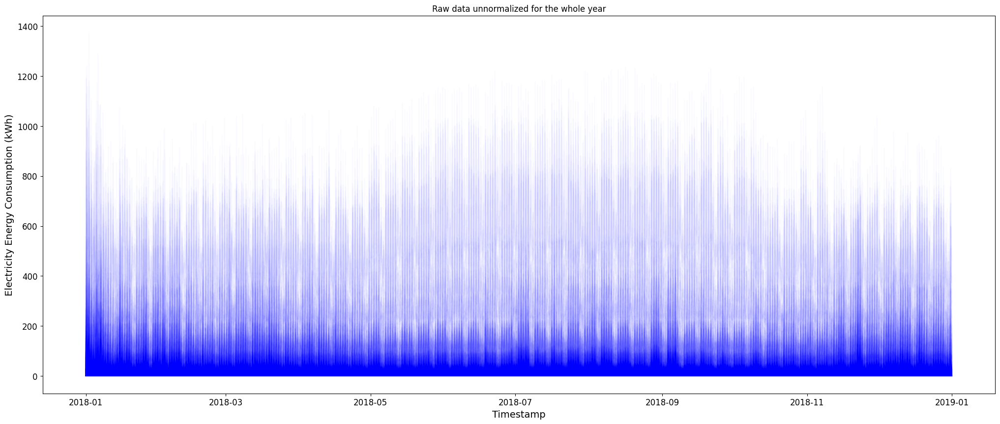

96546

In [3]:
# Define date range for the first plot
start_date = '2018-01-01 00:15:00'
end_date = '2019-01-01 00:00:00'

# Plot raw data
fig, ax = plt.subplots(figsize=(25, 10))
for building_id, df in data.groupby('building_id'):
    filtered_df = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    ax.plot(filtered_df['timestamp'], filtered_df['out.electricity.total.energy_consumption'], color='blue', alpha=0.02)

ax.set_xlabel('Timestamp', fontsize=14)
ax.set_ylabel('Electricity Energy Consumption (kWh)', fontsize=14)
ax.set_title('Raw data unnormalized for the whole year')
ax.tick_params(axis='both', labelsize=12)
plt.show()

del fig, ax, filtered_df, df
gc.collect()

This plot reveals that only a small number of buildings exhibit high energy demand, while the majority do not exceed 200 kWh. Additionally, we observe significant demand spikes during the colder and warmer months, indicating a seasonal pattern. To accurately capture and adjust for these variations, we will later on implement season-wise normalization to account for these seasonal differences.

In [4]:
# Define the kWh threshold
kwh_threshold = 200

# Check peak usage
peak_counts, total_counts = check_peak_usage(data, kwh_threshold)

# Calculate statistics
customers_with_peaks, total_customers, peak_occurrence_percentage = calculate_statistics(peak_counts, total_counts)

# Output results
print(f"\nNumber of customers with at least one peak > {kwh_threshold} kWh: {customers_with_peaks}")
print(f"Total number of buildings: {total_customers}")
# Additional statistics
percentage_with_peaks = (customers_with_peaks / total_customers) * 100
print(f"Percentage of buildings with at least one peak > {kwh_threshold} kWh: {percentage_with_peaks:.2f}%")
mean_peak_occurrence_percentage = sum(peak_occurrence_percentage) / len(peak_occurrence_percentage)
print(f"Mean percentage of peak occurrences across all buildings: {mean_peak_occurrence_percentage:.2f}%")


del peak_counts, total_counts, customers_with_peaks, total_customers, peak_occurrence_percentage, percentage_with_peaks, mean_peak_occurrence_percentage
gc.collect()


Number of customers with at least one peak > 200 kWh: 143
Total number of buildings: 1277
Percentage of buildings with at least one peak > 200 kWh: 11.20%
Mean percentage of peak occurrences across all buildings: 2.45%


0

Out of the 1277 Buildings, only 143 ever reach a consumption level of 200 kWh or higher, which are ~ 11%. Across all builings and datapoints, only ~2% exceed the 200 kWh threshold.

To get an better overview of the daily consumptions per builing are distributed, we create a histogram and see that the mean of the daily energy consumption per building is ~2000 kWh. The highest observed daily consumption is ~92.000 kWh and the lowest is 0.01 kWh.

In [5]:
data_consumption = copy.deepcopy(data)

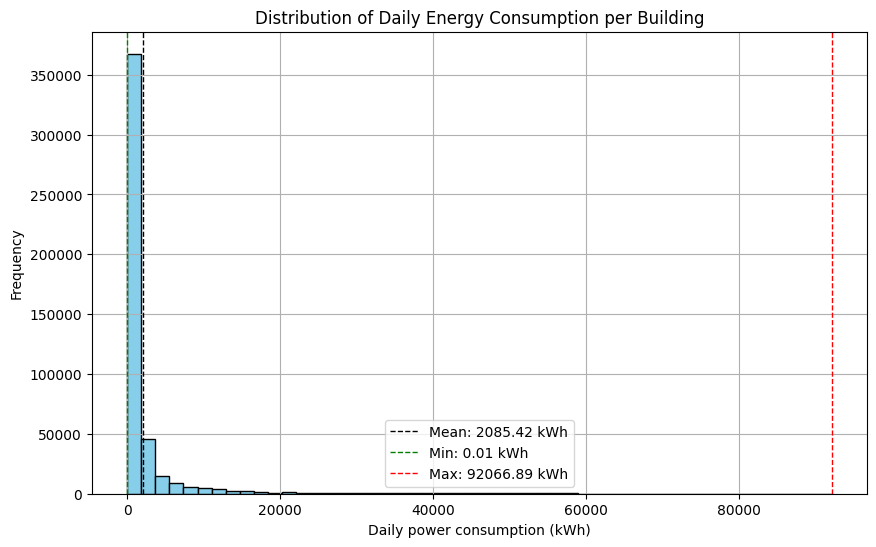

6958

In [6]:
# Ensure the timestamp is in datetime format
data_consumption['timestamp'] = pd.to_datetime(data_consumption['timestamp'])

# Set the timestamp as the index
data_consumption.set_index('timestamp', inplace=True)

# Calculate daily energy consumption per building
daily_consumption_per_building = data_consumption.groupby('building_id')['out.electricity.total.energy_consumption'].resample('D').sum()

# Reset index to make 'building_id' a column again
daily_consumption_per_building = daily_consumption_per_building.reset_index()

# Calculate statistics
mean_consumption = daily_consumption_per_building['out.electricity.total.energy_consumption'].mean()
min_consumption = daily_consumption_per_building['out.electricity.total.energy_consumption'].min()
max_consumption = daily_consumption_per_building['out.electricity.total.energy_consumption'].max()

# Plot the distribution of daily energy consumption per building
plt.figure(figsize=(10, 6))
plt.hist(daily_consumption_per_building['out.electricity.total.energy_consumption'], bins=50, color='skyblue', edgecolor='black')
plt.axvline(mean_consumption, color='black', linestyle='dashed', linewidth=1, label=f'Mean: {mean_consumption:.2f} kWh')
plt.axvline(min_consumption, color='green', linestyle='dashed', linewidth=1, label=f'Min: {min_consumption:.2f} kWh')
plt.axvline(max_consumption, color='red', linestyle='dashed', linewidth=1, label=f'Max: {max_consumption:.2f} kWh')
plt.xlabel('Daily power consumption (kWh)')
plt.ylabel('Frequency')
plt.title('Distribution of Daily Energy Consumption per Building')
plt.legend()
plt.grid(True)
plt.show()

# Clean up
del daily_consumption_per_building, data_consumption
gc.collect()

## 1.2) Daylight Saving Time and Holidays
As our keypoint of interest in this notebook is going to be the underlying pattern of each building, we investigate them in this section regardless of the absolute consumption level. For now, we only normalize the data based on the highest observed value per building to simplify the interpretations.

In [7]:
scaler = MinMaxScaler() # StandardScaler() # RobustScaler()
raw_data_normalized_plot = normalize_across_dataset(data, scaler=scaler)

Normalizing data for each building: 100%|██████████| 1277/1277 [00:10<00:00, 120.26it/s]


Although no geographical information is provided, we hypothesize that the buildings are most likely located in the United States based on variations in daylight saving times and holidays. In the U.S., daylight saving time starts on the second Sunday in March and ends on the first Sunday in November. By analyzing patterns before and after these dates, we observed a clear shift in energy demand, further suggesting that the buildings are situated in the U.S.

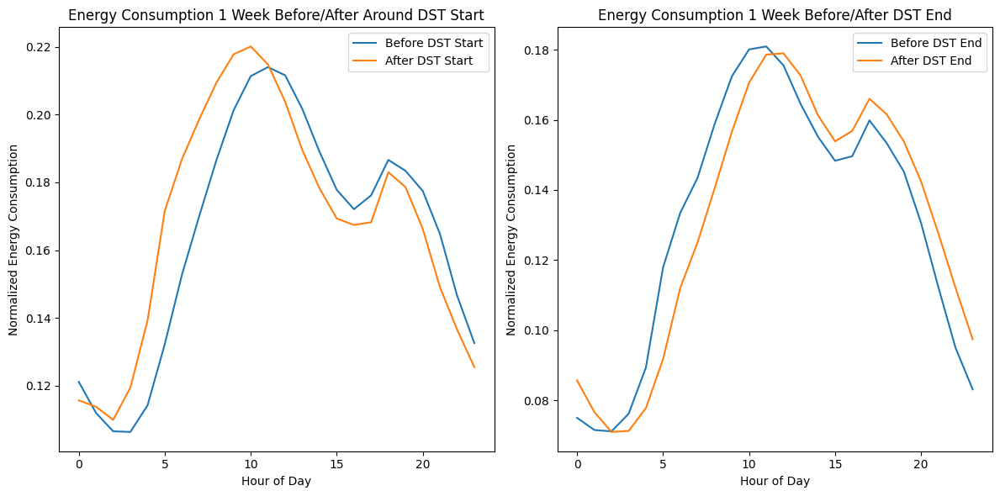

7110

In [8]:
# Ensure the concatenated normalized data has correct timestamp format
pd.options.mode.chained_assignment = None  # default='warn'
raw_data_normalized_plot['timestamp'] = pd.to_datetime(raw_data_normalized_plot['timestamp'])

# Define DST start and end dates for 2018
dst_start = pd.Timestamp('2018-03-11 02:00:00')  # Second Sunday in March
dst_end = pd.Timestamp('2018-11-04 02:00:00')    # First Sunday in November

# Function to extract data around DST transitions

# Extract data for both DST start and end transitions
before_dst_start, after_dst_start = extract_dst_period(raw_data_normalized_plot, dst_start)
before_dst_end, after_dst_end = extract_dst_period(raw_data_normalized_plot, dst_end)

before_dst_start_hourly = aggregate_by_hour(before_dst_start)
after_dst_start_hourly = aggregate_by_hour(after_dst_start)
before_dst_end_hourly = aggregate_by_hour(before_dst_end)
after_dst_end_hourly = aggregate_by_hour(after_dst_end)

# Plotting the results
plt.figure(figsize=(12, 6))

# DST Start
plt.subplot(1, 2, 1)
plt.plot(before_dst_start_hourly['hour'], before_dst_start_hourly['out.electricity.total.energy_consumption'], label='Before DST Start')
plt.plot(after_dst_start_hourly['hour'], after_dst_start_hourly['out.electricity.total.energy_consumption'], label='After DST Start')
plt.xlabel('Hour of Day')
plt.ylabel('Normalized Energy Consumption')
plt.title('Energy Consumption 1 Week Before/After Around DST Start')
plt.legend()

# DST End
plt.subplot(1, 2, 2)
plt.plot(before_dst_end_hourly['hour'], before_dst_end_hourly['out.electricity.total.energy_consumption'], label='Before DST End')
plt.plot(after_dst_end_hourly['hour'], after_dst_end_hourly['out.electricity.total.energy_consumption'], label='After DST End')
plt.xlabel('Hour of Day')
plt.ylabel('Normalized Energy Consumption')
plt.title('Energy Consumption 1 Week Before/After DST End')
plt.legend()

plt.tight_layout()
plt.show()

del before_dst_start_hourly, after_dst_start_hourly, before_dst_end_hourly, after_dst_end_hourly
gc.collect()

c:\Users\Anwender\Documents\Uni\SS_2024\Datateam\FINAL\.conda\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


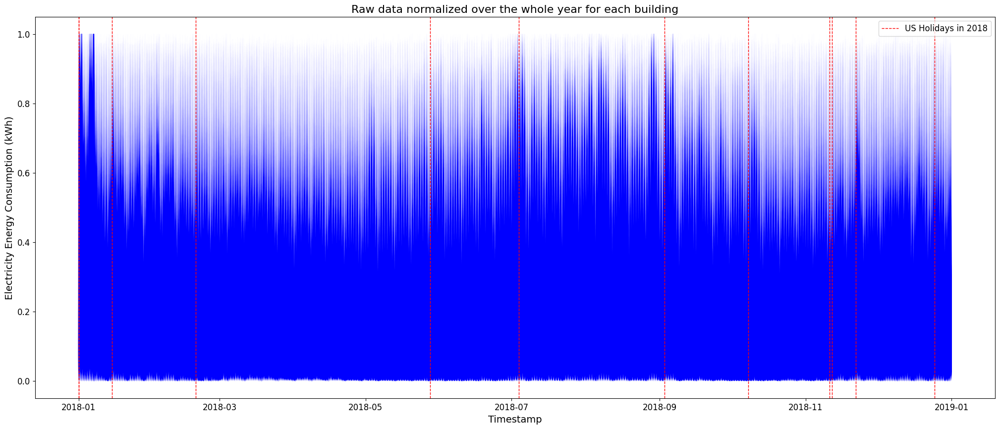

97512

In [9]:
import gc
import pandas as pd
import matplotlib.pyplot as plt

start_date = '2018-01-01 00:15:00'
end_date = '2019-01-01 00:00:00'

# Normalize the data and plot
holidays = [
    '2018-01-01', '2018-01-15', '2018-02-19', '2018-05-28',
    '2018-07-04', '2018-09-03', '2018-10-08', '2018-11-11',
    '2018-11-12', '2018-11-22', '2018-12-25'
]

holidays = pd.to_datetime(holidays)

# Plotting
fig, ax = plt.subplots(figsize=(25, 10))

for building_id, df in raw_data_normalized_plot.groupby('building_id'):
    # Filter data within the specified date/time range
    filtered_df = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    ax.plot(filtered_df['timestamp'], filtered_df['out.electricity.total.energy_consumption'], color='blue', alpha=0.002)

# Add vertical lines for holidays
for holiday in holidays:
    ax.axvline(holiday, color='r', linestyle='--', lw=1)

# Add a single legend entry for holidays
ax.axvline(holidays[0], color='r', linestyle='--', lw=1, label='US Holidays in 2018')

ax.legend(fontsize=12)
ax.set_xlabel('Timestamp', fontsize=14)
ax.set_ylabel('Electricity Energy Consumption (kWh)', fontsize=14)
ax.set_title('Raw data normalized over the whole year for each building', fontsize=16)
ax.tick_params(axis='both', labelsize=12)
plt.show()

# Release memory
del fig, ax, filtered_df, df
gc.collect()


In the normalized patterns we can observe a higher consumption at the beginning of the year, and a general relative increase of consumption in the time of June-October. For the holidays, we can not observe a clear difference in this plot. Therefore, we will investigate them further in the upcoming section.

## 1.3) Aggregated Profiles
In this subsection we investigate the changes in the energy consumption based on different aggregation level (e.g. daily profile, weekly profile).

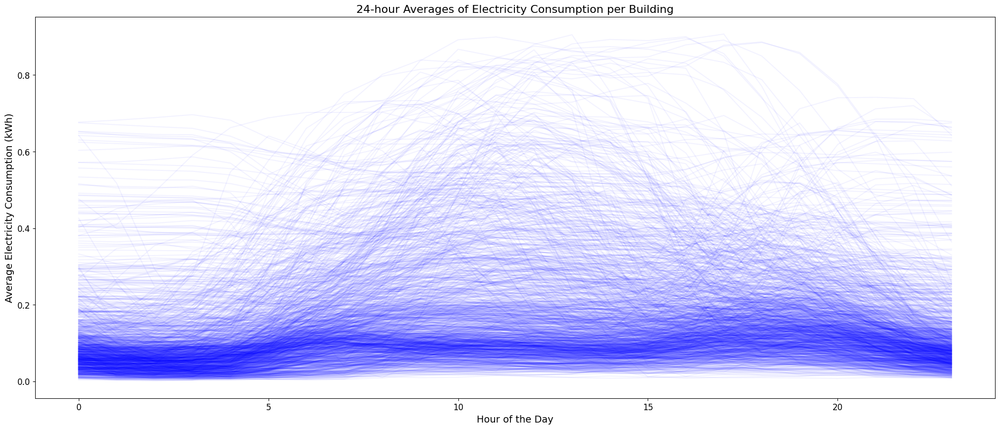

97919

In [10]:
# Ensure the dataframe has the correct timestamp format
raw_data_normalized_plot['timestamp'] = pd.to_datetime(raw_data_normalized_plot['timestamp'])

# Set the timestamp as the index
raw_data_normalized_plot.set_index('timestamp', inplace=True)

# Accumulate the data per hour
load_profiles_hourly_plot = raw_data_normalized_plot.groupby(['building_id', pd.Grouper(freq='1h')])['out.electricity.total.energy_consumption'].mean()
load_profiles_hourly_plot = load_profiles_hourly_plot.reset_index()

# Plotting
fig, ax = plt.subplots(figsize=(25, 10))

for building_id, group in load_profiles_hourly_plot.groupby('building_id'):
    # Extract hour of the day from the timestamp
    group = group.copy()  # Avoid SettingWithCopyWarning
    group['hour'] = group['timestamp'].dt.hour
    # Calculate the mean for each hour of the day
    hourly_avg = group.groupby('hour')['out.electricity.total.energy_consumption'].mean()
    ax.plot(hourly_avg.index, hourly_avg.values, color='blue', alpha=0.05)

ax.set_xlabel('Hour of the Day', fontsize=14)
ax.set_ylabel('Average Electricity Consumption (kWh)', fontsize=14)
ax.set_title('24-hour Averages of Electricity Consumption per Building', fontsize=16)
ax.tick_params(axis='both', labelsize=12)

plt.show()

del fig, ax, group, hourly_avg
gc.collect()

Let's see if we can observe changes in the 24 hour aggregations based on the seasons we observed in the previous plots.

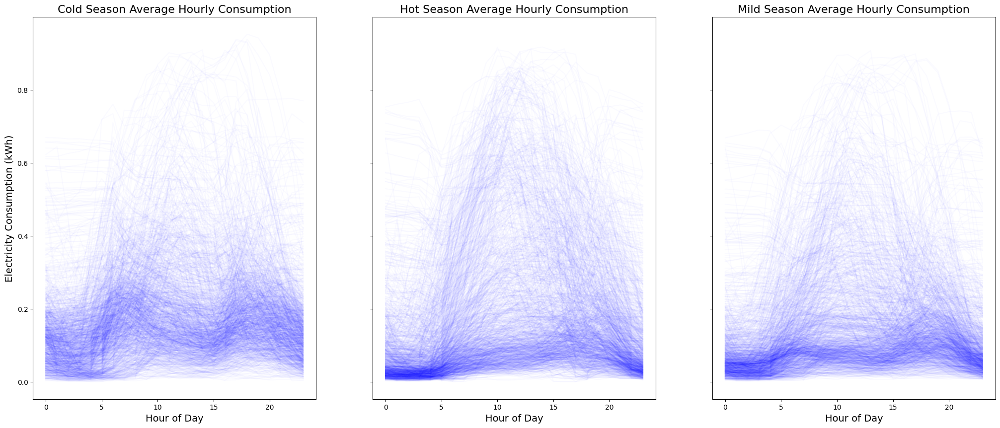

5135

In [11]:
SEASONS_MONTHS_DICT = {'cold': [1, 2, 12], 'hot': [6, 7, 8], 'mild': [3, 4, 5, 9, 10, 11]}

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(25, 10), sharey=True)

# Iterate over each season and plot the data
for ax, (season, months) in zip(axs, SEASONS_MONTHS_DICT.items()):
    # Filter data for the specific season
    seasonal_data = raw_data_normalized_plot[raw_data_normalized_plot.index.month.isin(months)]

    # Calculate the mean electricity consumption per hour for each building
    hourly_mean_data = seasonal_data.groupby(['building_id', pd.Grouper(freq='1h')])['out.electricity.total.energy_consumption'].mean()

    # Reset index to make it easier to work with
    hourly_mean_data = hourly_mean_data.reset_index()

    # Plotting
    for building_id, group in hourly_mean_data.groupby('building_id'):
        # Extract hour of the day from the timestamp
        group['hour'] = group['timestamp'].dt.hour
        # Calculate the mean for each hour of the day
        hourly_avg = group.groupby('hour')['out.electricity.total.energy_consumption'].mean()
        ax.plot(hourly_avg.index, hourly_avg.values, color='blue', alpha=0.02)

    ax.set_xlabel('Hour of Day', fontsize=14)
    ax.set_title(f'{season.capitalize()} Season Average Hourly Consumption', fontsize=16)

axs[0].set_ylabel('Electricity Consumption (kWh)', fontsize=14)
plt.show()

del fig, axs, seasonal_data, hourly_mean_data, group, hourly_avg
gc.collect()

The data presented in these plots indicates that the buildings in question can be classified into **at least** two distinct groups based on their energy consumption patterns. The majority of buildings exhibit a relatively low variance in energy consumption, while a smaller subset exhibits a high variance throughout all seasons. Furthermore, it appears that we have multiple patterns in there.


Next, we conduct further analysis similar to Yilmaz et al. (2019), who divided the daily profiles into four periods, based on the mean-power-demand of all buildings. We highlight that the mean of each period could further be used to extract features for a feature-based clustering method (Haben et al., 2019; Michalakopoulos et al., 2024).





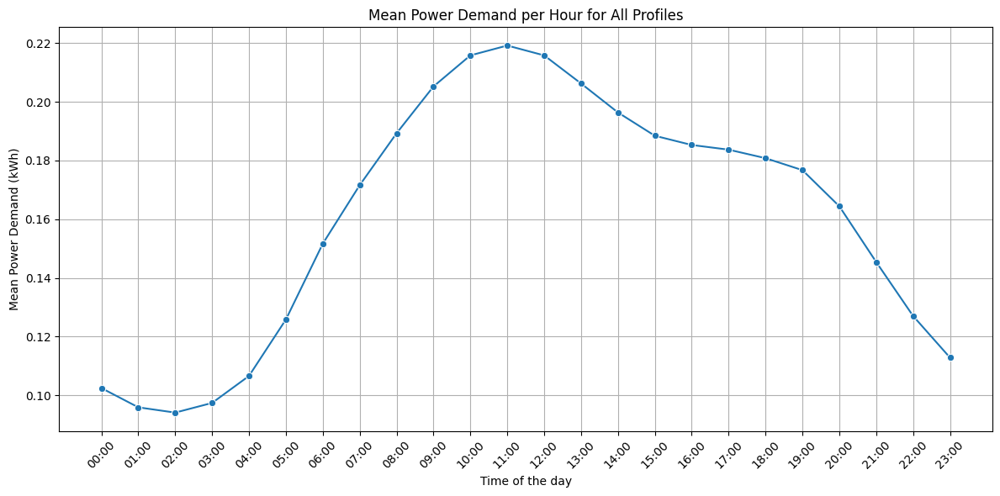

5409

In [12]:
# Reset index to extract hour
raw_data_normalized_plot = raw_data_normalized_plot.reset_index()

# Ensure the timestamp is in datetime format after resetting the index
raw_data_normalized_plot['timestamp'] = pd.to_datetime(raw_data_normalized_plot['timestamp'])

# Extract the hour from the timestamp
raw_data_normalized_plot['hour'] = raw_data_normalized_plot['timestamp'].dt.hour

# Group by hour and calculate the mean power demand
mean_hourly_demand = raw_data_normalized_plot.groupby('hour')['out.electricity.total.energy_consumption'].mean()

# Plotting the Mean Power Demand per Hour
plt.figure(figsize=(12, 6))
sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o')

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00' for hour in range(24)], rotation=45)
plt.title('Mean Power Demand per Hour for All Profiles')
plt.xlabel('Time of the day')
plt.ylabel('Mean Power Demand (kWh)')
plt.grid(True)
plt.tight_layout()
plt.show()

del mean_hourly_demand
gc.collect()


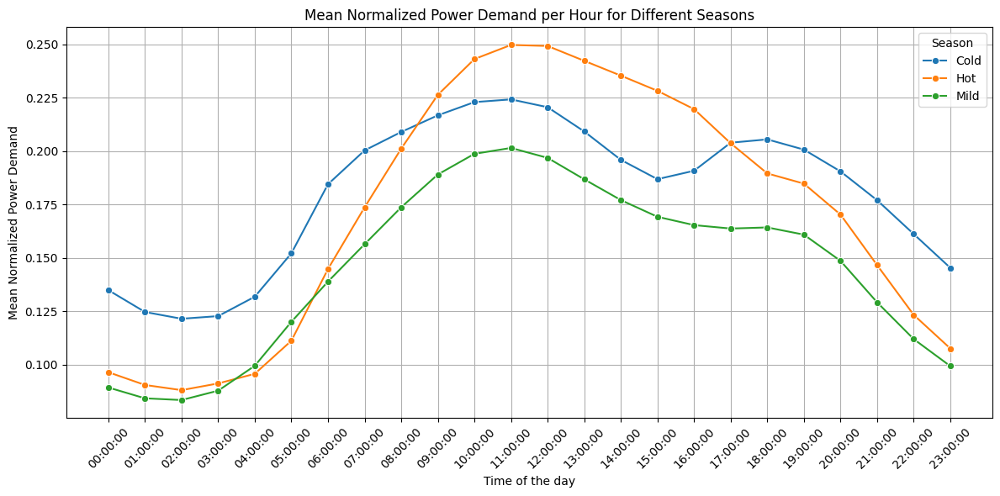

6640

In [13]:
#Extract month from raw_data_plot frame
raw_data_normalized_plot['month'] = raw_data_normalized_plot['timestamp'].dt.month

# Initialize the plot
plt.figure(figsize=(12, 6))

# Plotting for each season
for season, months in SEASONS_MONTHS_DICT.items():
    season_data = raw_data_normalized_plot[raw_data_normalized_plot['month'].isin(months)]

    # Group by hour and calculate the mean power demand for the season
    mean_hourly_demand = season_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the season
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=season.capitalize())

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Different Seasons')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between seasons
plt.legend(title='Season')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del season_data, mean_hourly_demand
gc.collect()

A statistical analysis of the mean-power-demand of the 24-hour representative load profiles for each season revealed that during the "cold" season, demand peaks twice: at 09:00-12:00 and 17:00-19:00. Furthermore, the demand is generally higher during the night and early morning hours in contrast to the demand observed during the hot seasons. The difference between the lowest and highest observed value is considerably greater than that observed during the cold months. Only a single peak occurs during the noon period (10:00-14:00) in hot and mild months.

Several authors including Haben et al. (2016), Rajabi et al. (2020), Trotta (2020), and Yilmaz et al. (2019) mention in their work that differntiation between weekdays and weekends is important, since the energy demand might shift depending on the day of the week. For this reason, the 24-hour representative load profile were also plotted in combination with the day of the week. This revealed that the mean normalized consumption of all buildings is higher during weekdays and lowest on sundays.

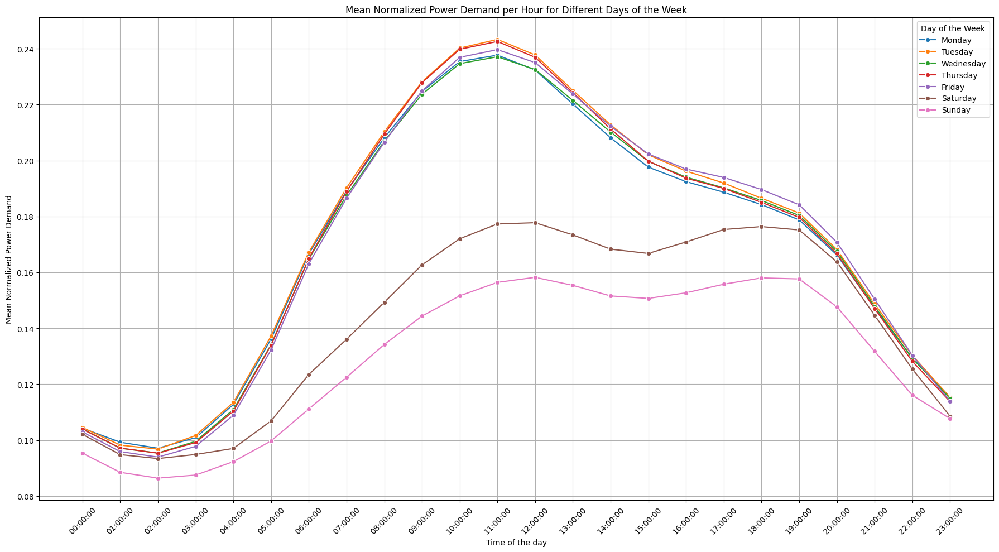

1238

In [14]:
# Add a 'day_of_week' column for filtering by day of the week
raw_data_normalized_plot = raw_data_normalized_plot.reset_index()
raw_data_normalized_plot['day_of_week'] = raw_data_normalized_plot['timestamp'].dt.day_name()

# Initialize the plot
plt.figure(figsize=(18, 10))

# Plotting for each day of the week
for day in raw_data_normalized_plot['day_of_week'].unique():
    day_data = raw_data_normalized_plot[raw_data_normalized_plot['day_of_week'] == day]

    # Group by hour and calculate the mean power demand for the day
    mean_hourly_demand = day_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the day
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=day)


# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Different Days of the Week')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between days of the week
plt.legend(title='Day of the Week')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del day_data, mean_hourly_demand
gc.collect()

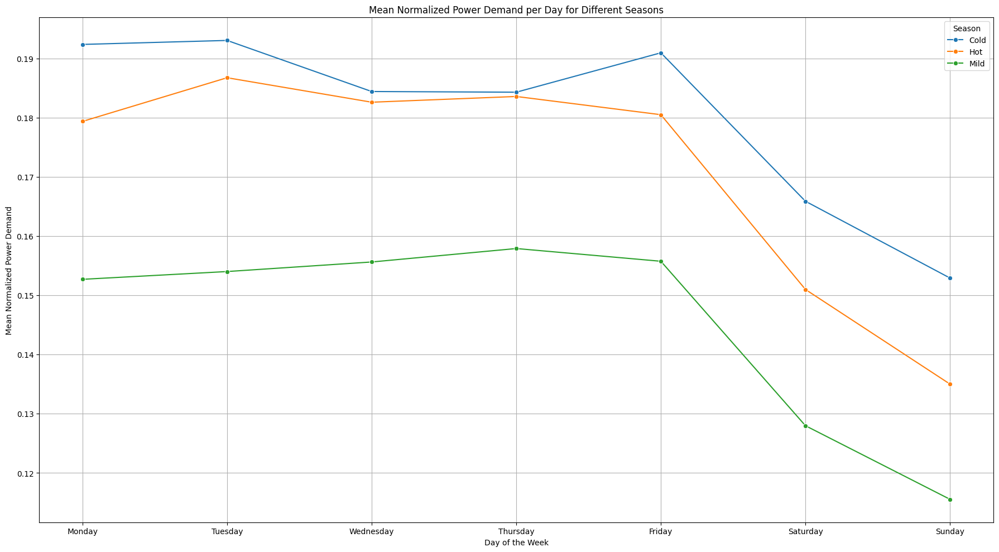

11807

In [15]:
# Initialize the plot
plt.figure(figsize=(18, 10))

# Plotting for each season
for season, months in SEASONS_MONTHS_DICT.items():
    season_data = raw_data_normalized_plot[raw_data_normalized_plot['month'].isin(months)]

    # Group by day of the week and calculate the mean power demand for the season
    mean_daily_demand = season_data.groupby('day_of_week')['out.electricity.total.energy_consumption'].mean()

    # Sort the index to ensure the days of the week are in order
    mean_daily_demand = mean_daily_demand.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

    # Plot the Mean Power Demand per Day for the season
    sns.lineplot(x=mean_daily_demand.index, y=mean_daily_demand.values, marker='o', label=season.capitalize())

# Set the title and labels
plt.title('Mean Normalized Power Demand per Day for Different Seasons')
plt.xlabel('Day of the Week')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between seasons
plt.legend(title='Season')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del season_data, mean_daily_demand
gc.collect()

Under the assumption that the buildings are located in the U.S. further features can be extracted and analyzed, like the mean consumption for all buildings during holiday vs. non-holiday.

Follwing holiday-days are defined:

- January 1, 2018 - New Year's Day
- January 15, 2018 - Martin Luther King Jr. Day
- February 19, 2018 - Presidents' Day
- May 28, 2018 - Memorial Day
- July 4, 2018 - Independence Day
- September 3, 2018 - Labor Day
- October 8, 2018 - Columbus Day
- November 11, 2018 - Veterans Day
- November 12, 2018 - Veterans Day (observed)
- November 22, 2018 - Thanksgiving Day
- December 25, 2018 - Christmas Day

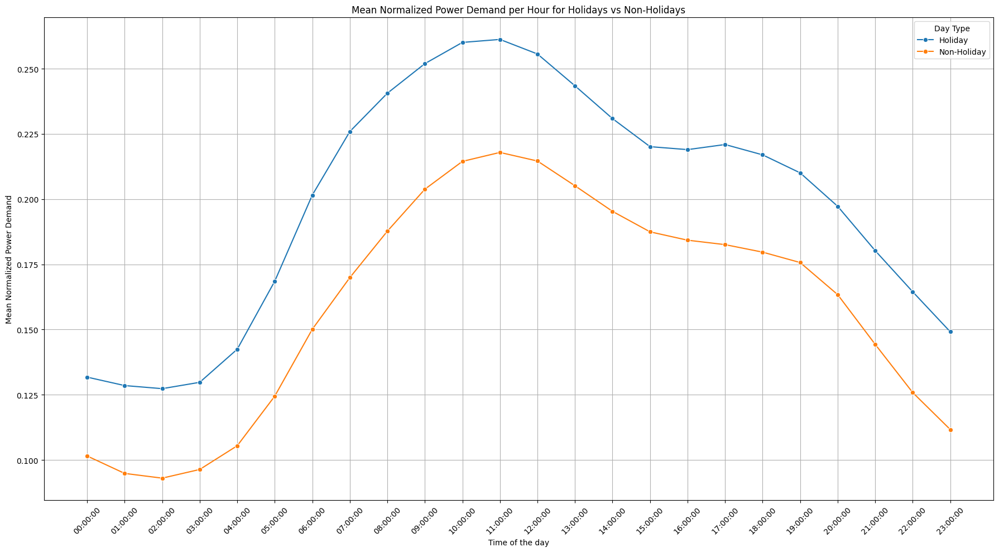

6176

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming raw_data_normalized_plot_conc is your DataFrame and it's already defined

# List of holidays
holidays = [
    '2018-01-01', '2018-01-15', '2018-02-19', '2018-05-28',
    '2018-07-04', '2018-09-03', '2018-10-08', '2018-11-11',
    '2018-11-12', '2018-11-22', '2018-12-25'
]

# Convert holidays to datetime
holidays = pd.to_datetime(holidays)

# Add a column to identify if the day is a holiday
raw_data_normalized_plot['is_holiday'] = raw_data_normalized_plot['timestamp'].dt.date.isin(holidays.date)

# Initialize the plot
plt.figure(figsize=(18, 10))

# Plotting for holidays and non-holidays
for label, is_holiday in [('Holiday', True), ('Non-Holiday', False)]:
    day_data = raw_data_normalized_plot[raw_data_normalized_plot['is_holiday'] == is_holiday]

    # Group by hour and calculate the mean power demand for the day
    mean_hourly_demand = day_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the day
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=label)

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Holidays vs Non-Holidays')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between holidays and non-holidays
plt.legend(title='Day Type')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del day_data, mean_hourly_demand
gc.collect()

It's clearly visible that during holiday the consumption is higher compared to non holiday.

Finally, to verify the seasons defined earlier, the mean of all buildings of the 24-hour representative load profile are visualized per month.


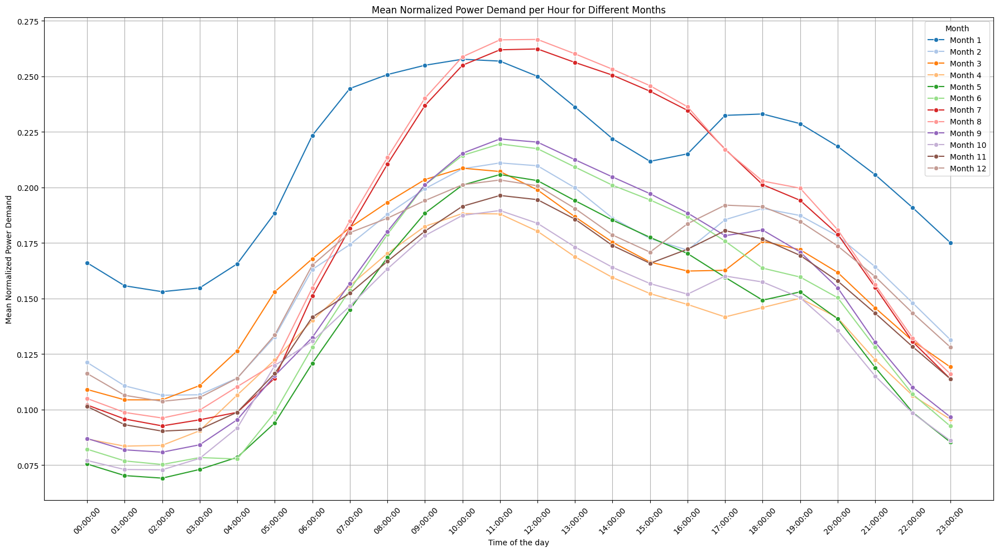

3012

In [17]:
# Initialize the plot
plt.figure(figsize=(18, 10))

# Use the 'tab20' color palette for distinct colors
palette = sns.color_palette("tab20", n_colors=12)

# Plotting for each month
for month, color in zip(raw_data_normalized_plot['month'].unique(), palette):
    month_data = raw_data_normalized_plot[raw_data_normalized_plot['month'] == month]

    # Group by hour and calculate the mean power demand for the month
    mean_hourly_demand = month_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the month
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=f'Month {month}', color=color)

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Different Months')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between months
plt.legend(title='Month')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del month_data, mean_hourly_demand, raw_data_normalized_plot
gc.collect()

The data for January, December and February can be considered to exhibit a similar pattern, with January exhibiting the highest mean consumption.
Similarly, the data for June, July and August can be considered to exhibit a similar shape, although it is evident that the mean demand is considerably higher in August and July than in June.

## 1.4) Impact of seasonal effects:

Throughout the above conducted EDA, which was based on yearly normalization, it got clear that the defined seasons (cold, mild, hot) have different characterisics. Since this challenge deals with the taks of finding and clustering same consumption patterns, regardless of the scale, we decided to account for the seasonal scale effects by normalizing within each season for all our applied methods. The following section should show the effects of normalizing within season compared to yearly.

In [18]:
raw_data_normalized_plot = normalize_seasonwise(data, scaler=scaler, seasons=SEASONS_MONTHS_DICT)

Because of the seasonal normalization, the cold season is now more comparable to the mild season.

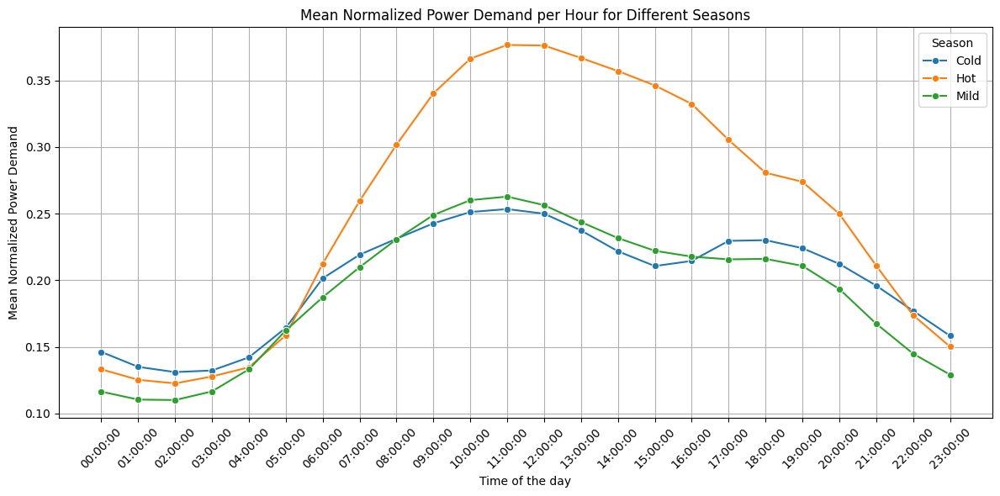

1431

In [19]:
# Extract month from raw_data_plot frame
# Reset index to extract hour
raw_data_normalized_plot = raw_data_normalized_plot.reset_index()

# Ensure the timestamp is in datetime format after resetting the index
raw_data_normalized_plot['timestamp'] = pd.to_datetime(raw_data_normalized_plot['timestamp'])

# Extract the hour from the timestamp
raw_data_normalized_plot['hour'] = raw_data_normalized_plot['timestamp'].dt.hour

raw_data_normalized_plot['timestamp'] = pd.to_datetime(raw_data_normalized_plot['timestamp'])
raw_data_normalized_plot['month'] = raw_data_normalized_plot['timestamp'].dt.month

# Initialize the plot
plt.figure(figsize=(12, 6))

# Plotting for each season
for season, months in SEASONS_MONTHS_DICT.items():
    season_data = raw_data_normalized_plot[raw_data_normalized_plot['month'].isin(months)]

    # Group by hour and calculate the mean power demand for the season
    mean_hourly_demand = season_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the season
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=season.capitalize())

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Different Seasons')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between seasons
plt.legend(title='Season')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del season_data, mean_hourly_demand
gc.collect()

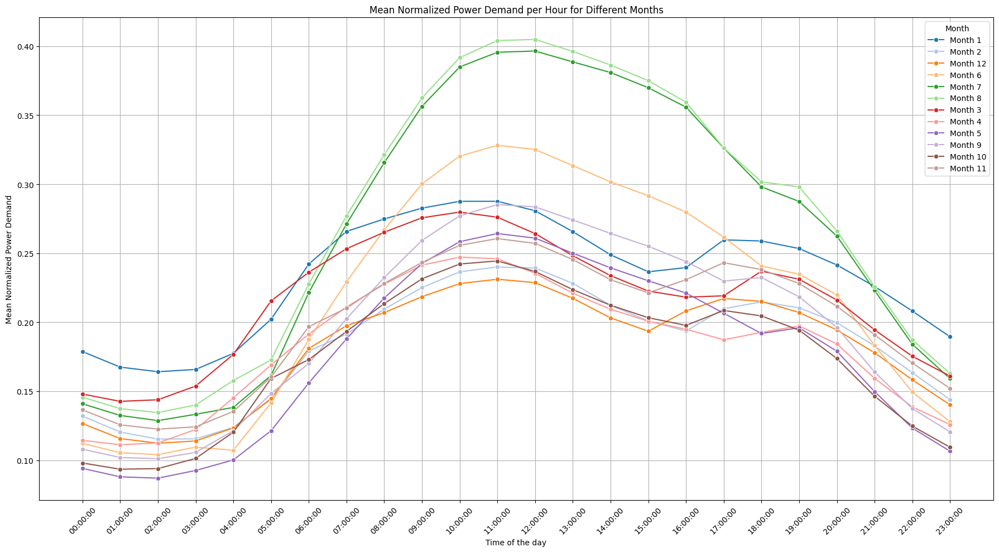

8943

In [20]:
# Initialize the plot
plt.figure(figsize=(18, 10))

# Use the 'tab20' color palette for distinct colors
palette = sns.color_palette("tab20", n_colors=12)

# Plotting for each month
for month, color in zip(raw_data_normalized_plot['month'].unique(), palette):
    month_data = raw_data_normalized_plot[raw_data_normalized_plot['month'] == month]

    # Group by hour and calculate the mean power demand for the month
    mean_hourly_demand = month_data.groupby('hour')['out.electricity.total.energy_consumption'].mean()

    # Plot the Mean Power Demand per Hour for the month
    sns.lineplot(x=mean_hourly_demand.index, y=mean_hourly_demand.values, marker='o', label=f'Month {month}', color=color)

# Set x-ticks to show every hour
plt.xticks(ticks=range(0, 24), labels=[f'{hour:02d}:00:00' for hour in range(24)], rotation=45)

# Set the title and labels
plt.title('Mean Normalized Power Demand per Hour for Different Months')
plt.xlabel('Time of the day')
plt.ylabel('Mean Normalized Power Demand')
plt.grid(True)

# Add legend to distinguish between months
plt.legend(title='Month')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

del month_data, mean_hourly_demand, raw_data_normalized_plot
gc.collect()

# 2) Methods
### Overview of our approaches:

K-Means was chosen for all different approaches as the clustering-algorithm. This choice was mainly based on the work of Jain et al. (2021), who claims that that while different clustering algorithms could slightly improve performance metrics like the silhouette coefficient and Davies–Bouldin index, the overall differences were not substantial and more importantly K-means performed comparably to other methods. Additinaly dimensionality reduction techniques like e.g. PCA were not chosen because of the work of Cen et al. (2022) different clustering frameworks, including those with dimensionality reduction steps, showed marginal differences in their performance when applied to load profiles. Furthermore using the features of PCA for clustering might also influence the interpretatbility of the formed clusters, and therefore we decided to use more traditional feature extraction and reduction techniques.  

We employ 4 different approaches:
- We cluster based on the manifold of an autoencoder
- We employ self organizing maps
- We explore dynamic time warping in two different resolutions
- We try handcrafted features based on our EDA and expert knowledge of given prior research

As for every clustering task, choosing the appropriate number of clusters (K) was critical in order to achieve some meaningful insights. To this end, we relied on the Silhouette score and the Elbow method, robusts metric for evaluating the quality of the resulted clusters. The silhouette score measures how similar each point in one cluster is to the points that are in the same cluster, compared to the points in other clusters, thereby quantifying the cohesion within clusters and the separation between clusters.

The silhouette score for a given point $i$ is defined as:

$s(i) = \frac{b(i) - a(i)}{\max(a(i), b(i))}$

where:
- $a(i)$ is the average distance between point $i$ and all other points in the same cluster.
- $b(i)$ is the minimum average distance from point $i$ to points in a different cluster.

The silhouette score ranges from -1 to 1, where a higher score indicates better-defined clusters.

To find the number of clusters 'K' that maximized the average silhouette score across all data points, we fitted each model for each method with values for K from the $\{2, 3, 4, 5, 6, 7, 8\}$ domain. After using this approach, we found out that for all the methods, a K equal to 4-6 was providing the best results in terms of the score. This approach ensures that the chosen value for K not only minimizes intra-cluster distances, but also maximizes inter-cluster distances (it enhances cohesion while also improving the clusters separation).

## 2.0) Data preparation

In [21]:
working_data = copy.deepcopy(data)
methods_labels = {}

In [22]:
normalized_data = normalize_seasonwise(working_data, scaler=scaler, seasons=SEASONS_MONTHS_DICT)
normalized_data.set_index('timestamp', inplace=True)

normalized_data_np = normalized_data.reset_index().pivot(index='building_id', columns='timestamp', values='out.electricity.total.energy_consumption').to_numpy()

daily_aggregation = normalized_data.groupby(['building_id', pd.Grouper(freq='D')])['out.electricity.total.energy_consumption'].mean()
daily_aggregation_np = daily_aggregation.reset_index().pivot(index='building_id', columns='timestamp', values='out.electricity.total.energy_consumption').to_numpy()

hourly_aggregation = normalized_data.groupby(['building_id', pd.Grouper(freq='8h')])['out.electricity.total.energy_consumption'].mean()
hourly_aggregation_np = hourly_aggregation.reset_index().pivot(index='building_id', columns='timestamp', values='out.electricity.total.energy_consumption').to_numpy()

For a visual evaluation we employ several plots on different aggregation levels. One resolution is "weekly", where we employ a slight offset as the first week of january is not the most representative for the clusters due to the holidays.

In [23]:
weekly_offset = 24 * 7 * 2 * 4 # start after 2 weeks

## 2.1) Clustering the Local Manifold of an Autoencoded Embedding

This method is based on the method proposed by McConville et al. (2020).
The idea is to learn a latent representation with an autoencoder, followed by a deeper exploration of the manifold with clustering.
Hyperparameters of the Autoencoder and the manifold learning method (UMAP) were initially based on the respective paper. Increasing the Autoencoders Layers by a multiple of 4 yielded the best results based on our evaluation.

In [24]:
LAYER_SIZE_MULTIPLIER = 4

def autoencoder(dims, act='relu'):
    n_stacks = len(dims) - 1
    x = Input(shape=(dims[0],), name='input')
    h = x
    for i in range(n_stacks - 1):
        h = Dense(dims[i + 1], activation=act, name='encoder_%d' % i)(h)
    h = Dense(dims[-1], name='encoder_%d' % (n_stacks - 1))(h)
    for i in range(n_stacks - 1, 0, -1):
        h = Dense(dims[i], activation=act, name='decoder_%d' % i)(h)
    h = Dense(dims[0], name='decoder_0')(h)

    return Model(inputs=x, outputs=h)

shape = [normalized_data_np.shape[-1], 500 * LAYER_SIZE_MULTIPLIER, 500 * LAYER_SIZE_MULTIPLIER, 2000 * LAYER_SIZE_MULTIPLIER, 4 * LAYER_SIZE_MULTIPLIER]
autoencoder = autoencoder(shape)

hidden = autoencoder.get_layer(name='encoder_%d' % (len(shape) - 2)).output
encoder = Model(inputs=autoencoder.input, outputs=hidden)

autoencoder.compile(loss='mse', optimizer='adam')
autoencoder.fit(
    normalized_data_np,
    normalized_data_np,
    batch_size=32,
    epochs=1,
    verbose=0)

hl = encoder.predict(normalized_data_np)
hl_manifold = umap.UMAP(n_components=8, n_neighbors=20, min_dist=0).fit_transform(hl)




40/40 [==============================] - 1s 15ms/step


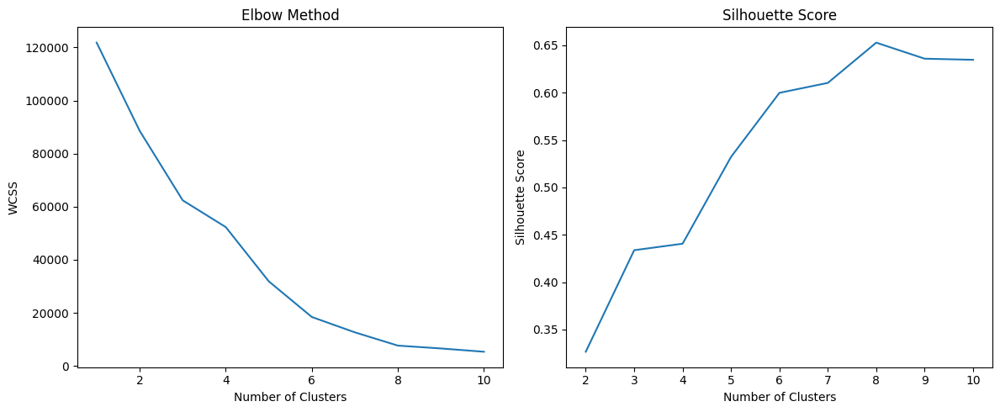

In [25]:
# Initialize figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Plot the Elbow Method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42, n_init='auto')
    kmeans.fit(hl_manifold)
    wcss.append(kmeans.inertia_)
axes[0].plot(range(1, 11), wcss)
axes[0].set_title('Elbow Method')
axes[0].set_xlabel('Number of Clusters')
axes[0].set_ylabel('WCSS')

# Plot the Silhouette Score
silhouette_scores = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42, n_init='auto')
    labels = kmeans.fit_predict(hl_manifold)
    silhouette_scores.append(silhouette_score(hl_manifold, labels))
axes[1].plot(range(2, 11), silhouette_scores)
axes[1].set_title('Silhouette Score')
axes[1].set_xlabel('Number of Clusters')
axes[1].set_ylabel('Silhouette Score')

# Show the plots
plt.tight_layout()
plt.show()

In [26]:
clustering_model = KMeans(n_clusters=5, init='k-means++', random_state=42, n_init='auto')
clustering_labels = clustering_model.fit_predict(hl_manifold)
methods_labels["LmAE"] = clustering_labels

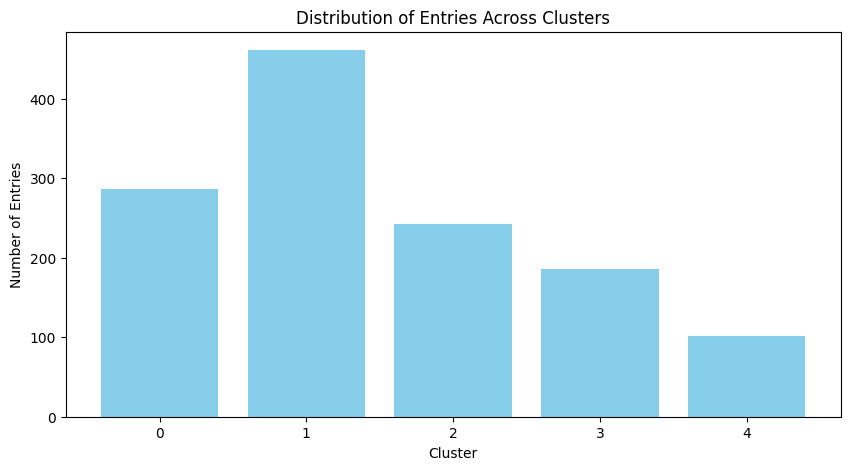

In [27]:
plot_cluster_distributions(clustering_labels)

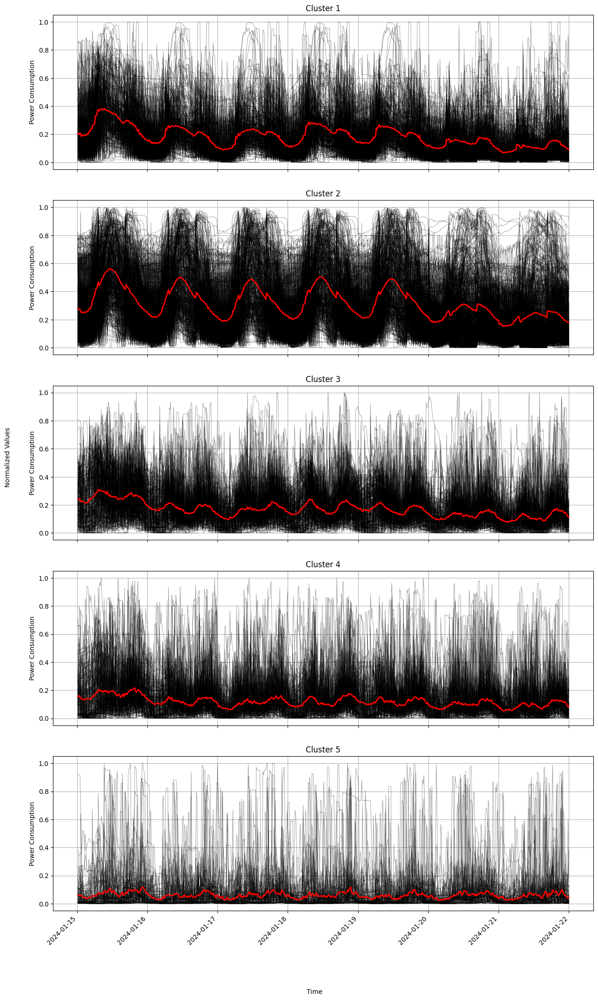

In [28]:
plot_clusters(clustering_labels, normalized_data_np, duration='week', offset=weekly_offset)

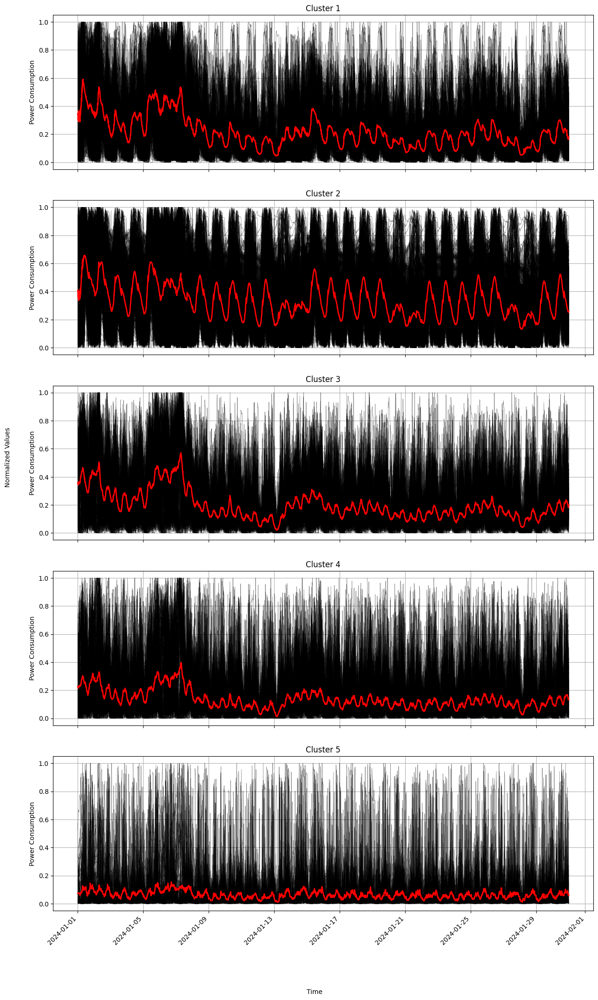

In [29]:
plot_clusters(clustering_labels, normalized_data_np, duration='month')

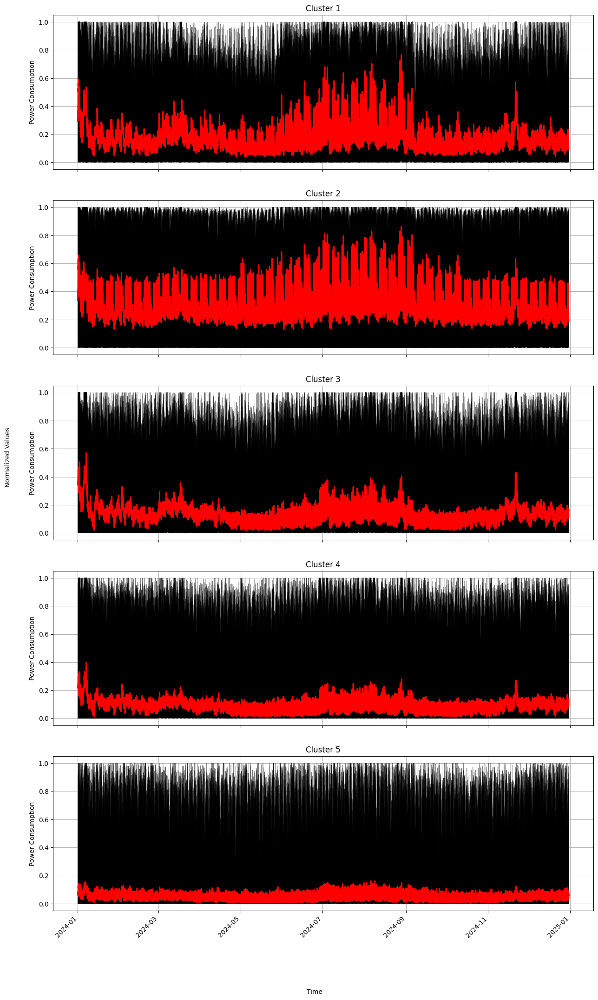

In [30]:
plot_clusters(clustering_labels, normalized_data_np)

In [31]:
autoenc_manifold_metrics = compute_metrics(normalized_data_np, clustering_labels, print_metrics=True)

Silhouette index: 0.020301385527115502
Davies-Bouldin index: 3.3829106156227065
Dunn index: 0.049662510245591915
Hartigan index: 1.6447343596805675
Calinski-Harabasz index: 193.344291817288


## 2.2) Self Organizing Maps

In [32]:
som_x, som_y = 2, 2
map_size = (som_x, som_y)  # NN size
input_len = normalized_data_np.shape[1]  # Number of features

# Initialize the SOM
som = MiniSom(map_size[0], map_size[1], input_len, sigma=0.3, learning_rate=0.1, random_seed=seed)
som.random_weights_init(normalized_data_np)
som.train_random(normalized_data_np, 1000)  # Adjust the number of iterations as needed

# Get the coordinates of the best matching units (BMUs) for each data point
bmu_coordinates = np.array([som.winner(x) for x in normalized_data_np])

# Get the clusters (grid points) of the SOM
clusters = {}
for i, (x, y) in enumerate(bmu_coordinates):
    if (x, y) not in clusters:
        clusters[(x, y)] = []
    clusters[(x, y)].append(i)

clustering_labels = np.zeros(normalized_data_np.shape[0], dtype=int)

for cluster_index, (cluster, building_indices) in enumerate(clusters.items()):
    for building_index in building_indices:
        clustering_labels[building_index] = cluster_index
    print(f"Cluster {cluster}:")
    print(f"Buildings: {building_indices}")

methods_labels["som"] = clustering_labels

Cluster (1, 1):
Buildings: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 93, 94, 95, 96, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 228, 229, 2

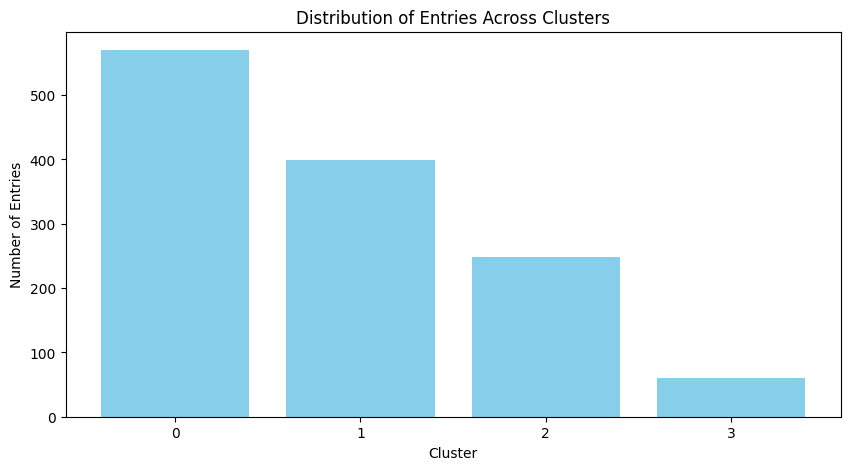

In [33]:
plot_cluster_distributions(clustering_labels)

In [34]:
def plot_clusters(final_labels, data_normalized, duration='all', offset=0):
    """
    Plot time series clusters and their mean consumption.

    Parameters:
    - final_labels (array-like): Array containing cluster labels assigned to each data entry.
    - data_normalized (numpy.ndarray): Normalized data array suitable for clustering.
    - duration (str, optional): Duration for which to display data ('all', 'week', 'month', etc.). Defaults to 'all'.
    - offset (in hours) when plotting
    Returns:
    - None (displays plots).
    """
    # Calculate mean consumption for each cluster
    cluster_means = {}
    for label in np.unique(final_labels):
        cluster_data = data_normalized[final_labels == label]
        cluster_means[label] = cluster_data.mean(axis=0)  # Mean across rows/buildings

    # Number of clusters
    n_clusters = len(np.unique(final_labels))

    # Determine the number of data points to display based on duration
    if duration == 'all':
        num_data_points = data_normalized.shape[1] + offset
    elif duration == 'week':
        num_data_points = 7 * 24 + offset # 7 days * 24 hours
    elif duration == 'month':
        num_data_points = 30 * 24 + offset # 30 days * 24 hours
    else:
        raise ValueError("Invalid duration. Options are 'all', 'week', or 'month'.")

    # Create subplots - one for each cluster
    fig, axs = plt.subplots(n_clusters, 1, figsize=(15, n_clusters * 5), sharex=True)

    # Plot each building's time series and the cluster mean
    for ax, label in zip(axs, np.unique(final_labels)):
        # Plot each building's time series
        cluster_data = data_normalized[final_labels == label][:, offset:num_data_points]
        for idx in range(cluster_data.shape[0]):
            ax.plot(cluster_data[idx], 'k-', alpha=0.5, linewidth=0.5)

        # Plot the cluster's mean consumption
        ax.plot(cluster_means[label][offset:num_data_points], 'r-', linewidth=2)

        # Formatting the plot
        ax.set_title(f'Cluster {label + 1}')
        ax.set_ylabel('Power Consumption')
        ax.grid(True)

    # Set common labels
    fig.text(0.5, 0.04, 'Hour', ha='center', va='center')
    fig.text(0.06, 0.5, 'Normalized Values', ha='center', va='center', rotation='vertical')

    plt.show()

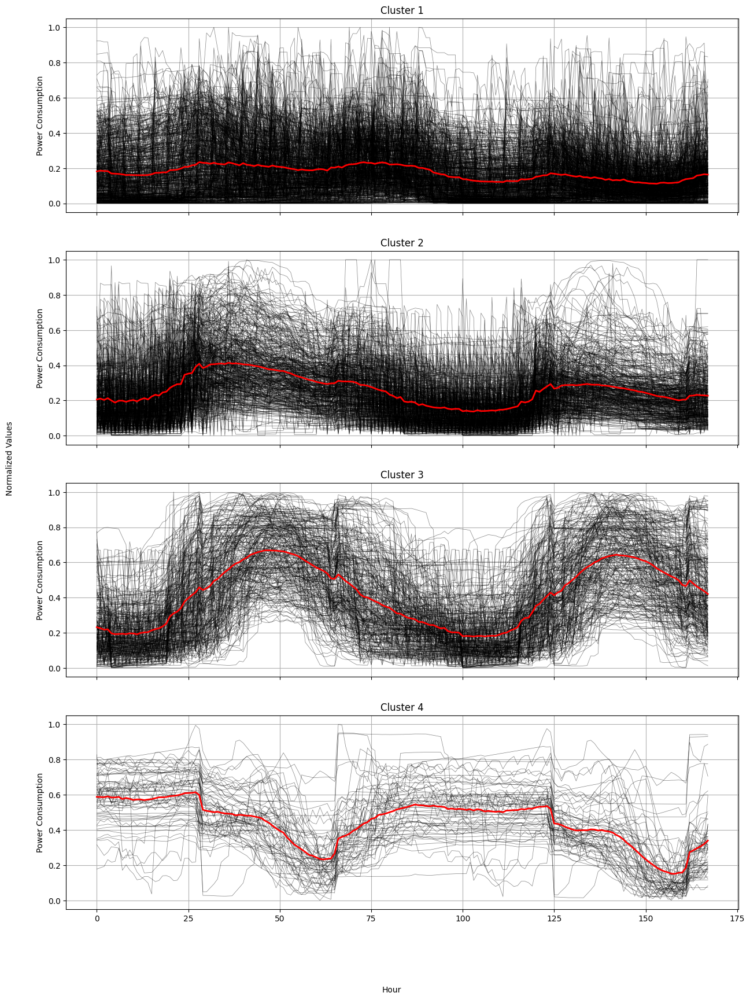

In [35]:
plot_clusters(clustering_labels, normalized_data_np, duration='week', offset=weekly_offset)

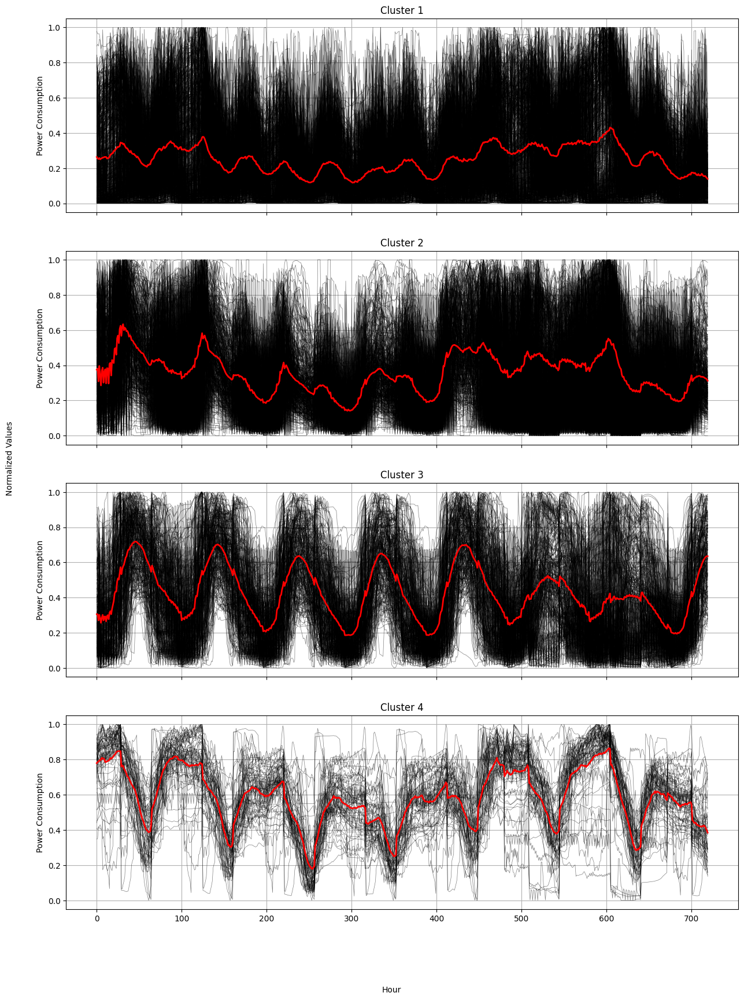

In [36]:
plot_clusters(clustering_labels, normalized_data_np, duration='month')

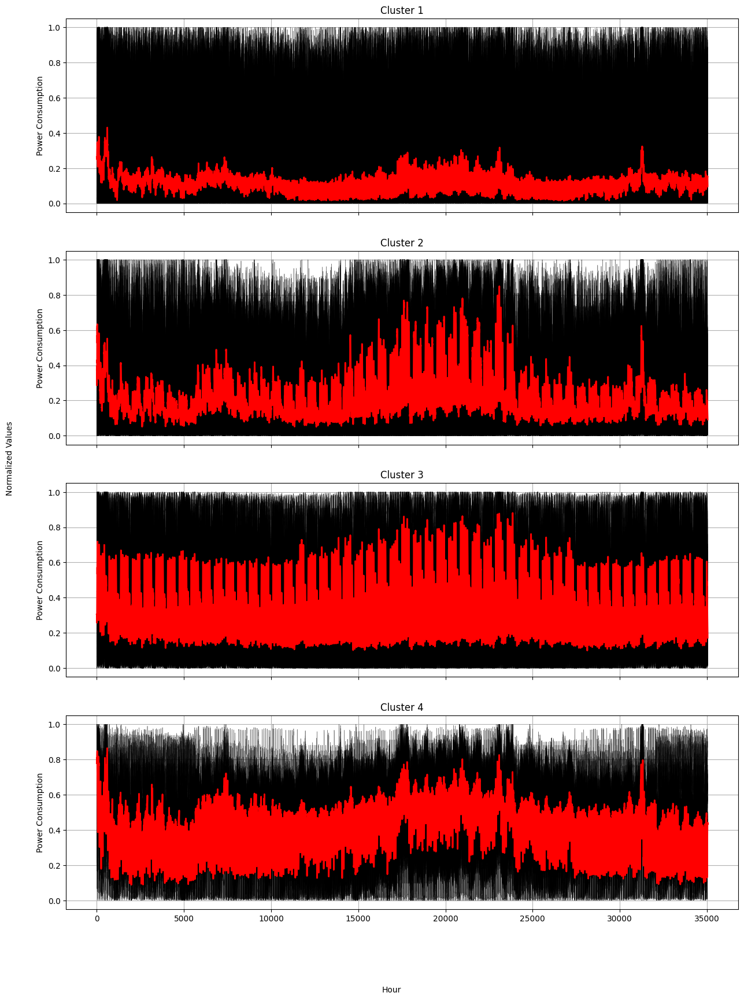

In [37]:
plot_clusters(clustering_labels, normalized_data_np)

In [38]:
som_metrics = compute_metrics(normalized_data_np, clustering_labels, print_metrics=True)

Silhouette index: 0.20360103211115488
Davies-Bouldin index: 1.7224868689270116
Dunn index: 0.0536637828394779
Hartigan index: 1.2367037576164936
Calinski-Harabasz index: 343.11639365530306


## 2.3) Dynamic time warping K-Means

### 2.3.1) Daily aggregated values

In [39]:
def save_or_load_model(model_filename, n_clusters, data_np):
    if os.path.exists(model_filename):
        # Load the model
        kmeans_model = joblib.load(model_filename)
        kmeans_labels = kmeans_model.predict(data_np)
        print(f"Model loaded from {model_filename}.")
    else:
        # Fit the model
        kmeans_model = TimeSeriesKMeans(n_clusters=n_clusters, metric="dtw", verbose=False)
        kmeans_labels = kmeans_model.fit_predict(data_np)
        
        # Save the model to a file
        joblib.dump(kmeans_model, model_filename)
        print(f"Model fitted and saved to {model_filename}.")
    return kmeans_model, kmeans_labels

daily_model_filename = 'daily_kmeans_model.joblib'
daily_kmeans_model, daily_kmeans_labels = save_or_load_model(daily_model_filename, 5, daily_aggregation_np)
methods_labels["dkm"] = daily_kmeans_labels

c:\Users\Anwender\Documents\Uni\SS_2024\Datateam\FINAL\.conda\lib\site-packages\tslearn\utils\utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 1277 1-dimensional timeseries
  warnings.warn(


Model loaded from daily_kmeans_model.joblib.


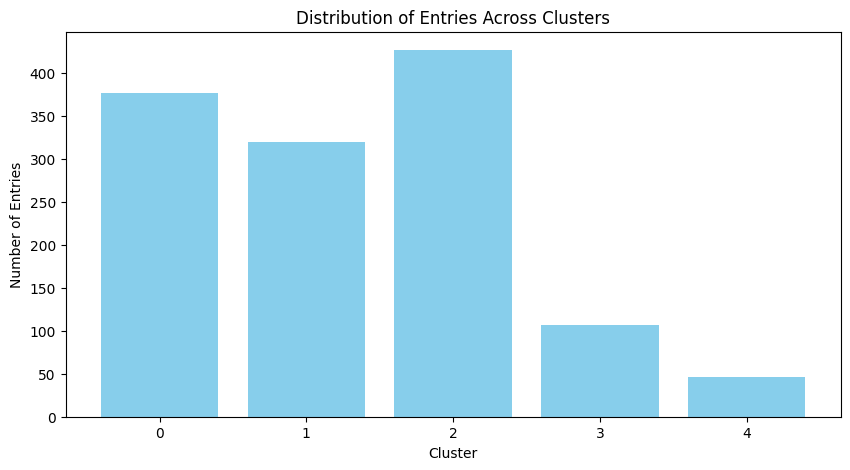

In [40]:
plot_cluster_distributions(daily_kmeans_labels)

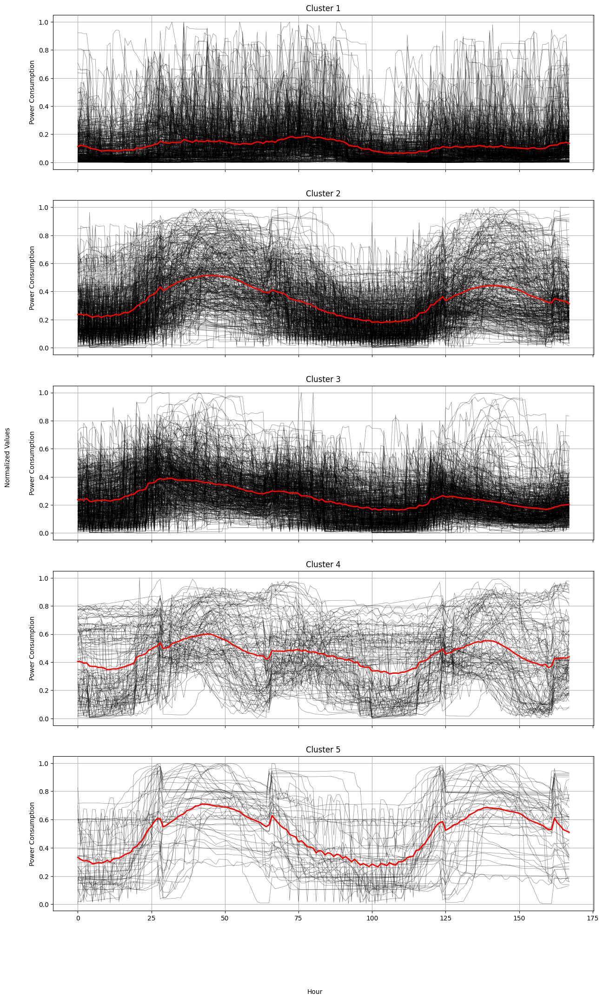

In [41]:
plot_clusters(daily_kmeans_labels, normalized_data_np, duration='week', offset=weekly_offset)

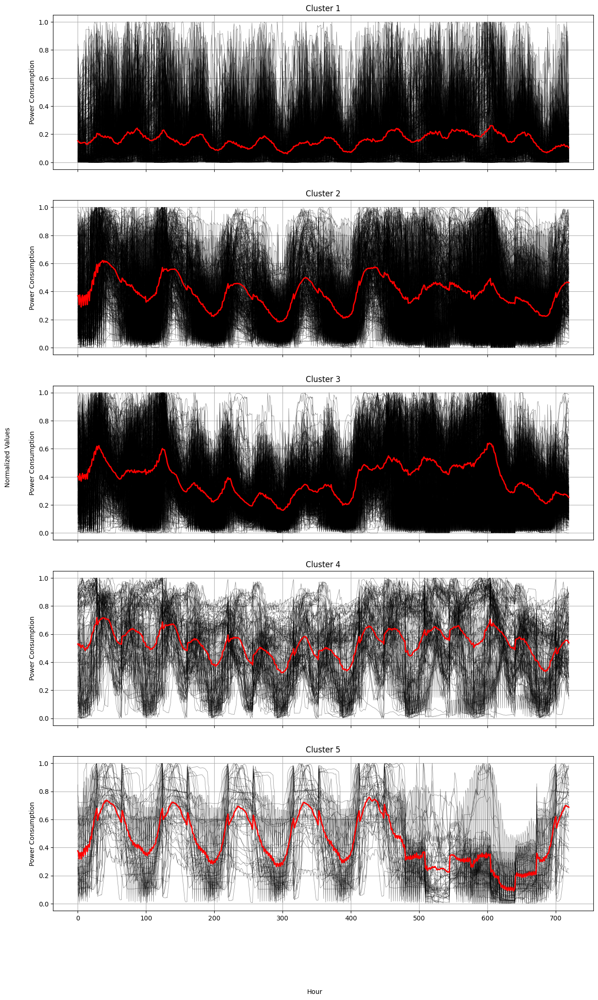

In [42]:
plot_clusters(daily_kmeans_labels, normalized_data_np, duration='month')

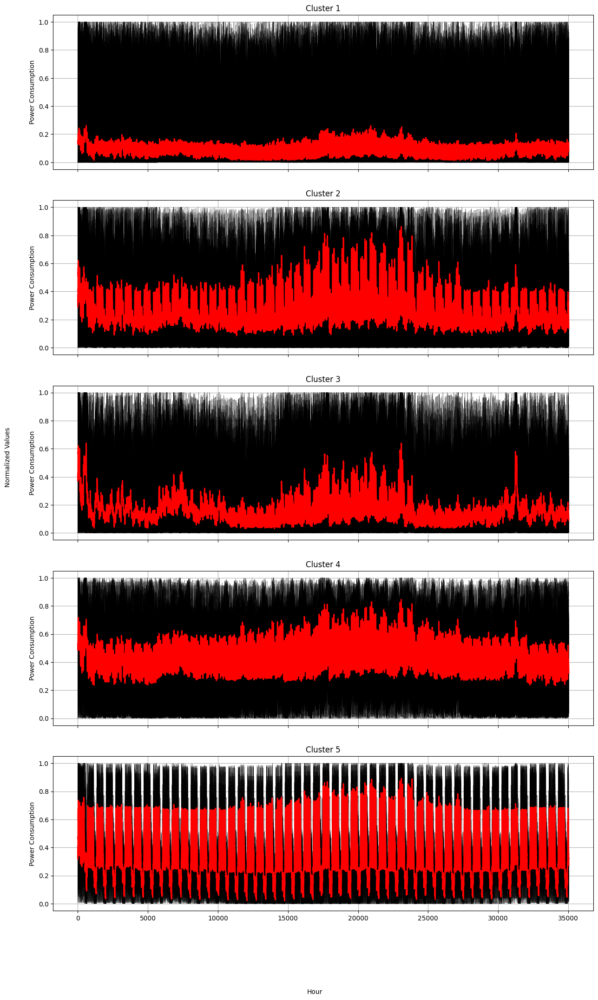

In [43]:
plot_clusters(daily_kmeans_labels, normalized_data_np)

In [44]:
daily_dtw_kmeans_metrics = compute_metrics(normalized_data_np, daily_kmeans_labels, print_metrics=True)

Silhouette index: 0.09511185050033838
Davies-Bouldin index: 2.233621854010499
Dunn index: 0.053644489300786725
Hartigan index: 1.4658416035995392
Calinski-Harabasz index: 216.94022002044096


### 2.3.2) Hourly Aggregated values

In [45]:
hourly_model_filename = 'hourly_kmeans_model.joblib'
hourly_kmeans_model, hourly_kmeans_labels = save_or_load_model(hourly_model_filename, 5, hourly_aggregation_np)

methods_labels["hkm"] = hourly_kmeans_labels

c:\Users\Anwender\Documents\Uni\SS_2024\Datateam\FINAL\.conda\lib\site-packages\tslearn\utils\utils.py:90: UserWarning: 2-Dimensional data passed. Assuming these are 1277 1-dimensional timeseries
  warnings.warn(


Model loaded from hourly_kmeans_model.joblib.


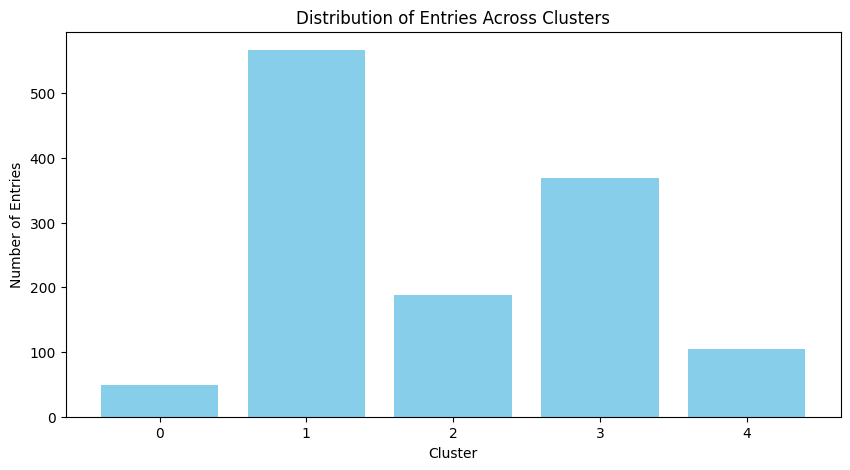

In [46]:
plot_cluster_distributions(hourly_kmeans_labels)

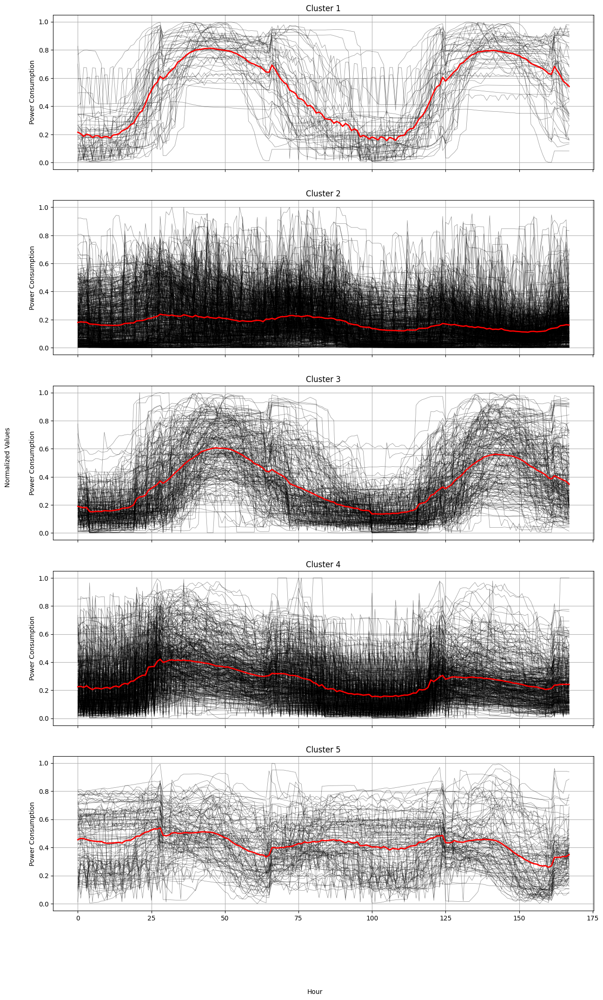

In [47]:
plot_clusters(hourly_kmeans_labels, normalized_data_np, duration='week', offset=weekly_offset)

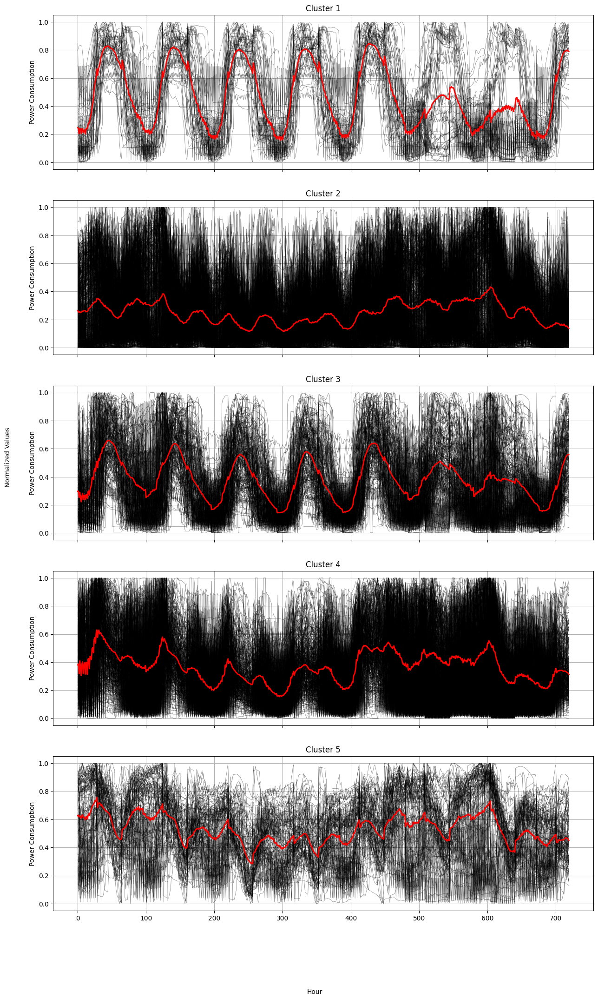

In [48]:
plot_clusters(hourly_kmeans_labels, normalized_data_np, duration='month')

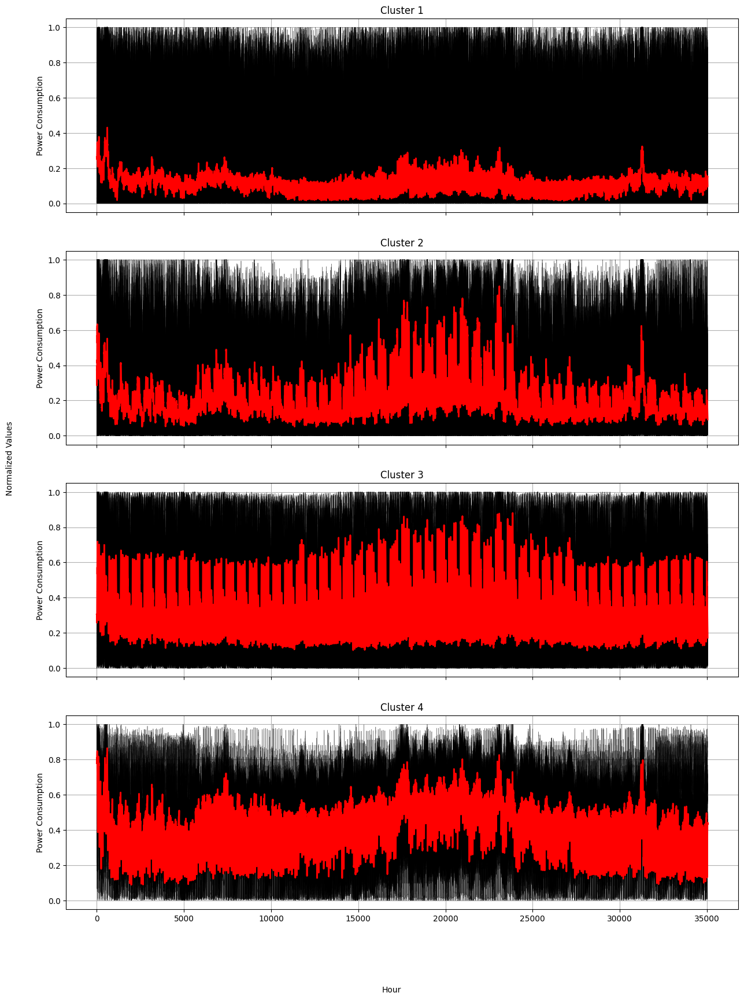

In [49]:
plot_clusters(clustering_labels, normalized_data_np)

In [50]:
hourly_dtw_kmeans_metrics = compute_metrics(normalized_data_np, hourly_kmeans_labels, print_metrics=True)

Silhouette index: 0.17534790103789422
Davies-Bouldin index: 2.21359082716324
Dunn index: 0.053079622179222206
Hartigan index: 1.3164035515654289
Calinski-Harabasz index: 241.56726075514126


## 2.4) Feature Based Approach with K-Means

In total 175 are extracted from the load-profiles. The features are the follwing:
- 2 features: statistical features (mean/std) of the overall profile
- 24 feature: 24h RLP over whole year of the whole series
- 72 features: 3 x 24h RLP for each season (cold, mild, hot)
- 24 features: mean/std for each month
- 2 features: mean for  weekend/weekday
- 2 features: mean for holiday/non-holiday
- 48 featrues: 2 x 24-hour RLP for weekdays/weekends
- 1 feature: date of highest consumption (as day of the year)

The motivation for choosing these features is based on the conduced EDA. K-Means is then used as the clustering-algorithm. Furhtemore both statistical features as well as RLP are used, which aligns with the approaches of Haben et al. (2019), and Yilmaz et al. (2019), who use similar features and point out the importance of using a diverse set of features, including statistical ones, but also aggregated ones.

In [51]:
HOLIDAYS = [
    '2018-01-01', '2018-01-15', '2018-02-19', '2018-05-28',
    '2018-07-04', '2018-09-03', '2018-10-08', '2018-11-11',
    '2018-11-12', '2018-11-22', '2018-12-25'
]

HOLIDAYS = [pd.Timestamp(date) for date in HOLIDAYS]

# Define holidays
holidays = [pd.Timestamp(date) for date in HOLIDAYS]

data = normalized_data.reset_index()

if 'season' in data.columns:
    data = data.drop(columns=['season'])

In [52]:
# Apply the feature extraction to all buildings
feature_list = []
for building_id, group in tqdm(data.groupby('building_id'), desc="Extracting features..."):
    features = extract_statistical_features(group)
    features['building_id'] = building_id
    feature_list.append(features)

features_df = pd.DataFrame(feature_list)
features_df.set_index('building_id', inplace=True)
pd.reset_option('all')
features_df.head()

Extracting features...: 100%|██████████| 1277/1277 [00:39<00:00, 32.72it/s]


,mean,std,daily_0,daily_1,daily_2,daily_3,daily_4,daily_5,daily_6,daily_7,...,weekend_15,weekend_16,weekend_17,weekend_18,weekend_19,weekend_20,weekend_21,weekend_22,weekend_23,max_consumption_day_of_year
building_id,,,,,,,,,,,,,,,,,,,,,
1,0.159250,0.117214,0.106231,0.097678,0.097344,0.100161,0.105241,0.124989,0.152646,0.173501,...,0.172568,0.200300,0.217601,0.238274,0.246412,0.233887,0.178901,0.139607,0.115574,7
2,0.138484,0.127572,0.098885,0.104424,0.100965,0.098848,0.088444,0.115015,0.174752,0.175870,...,0.145188,0.155160,0.158287,0.156044,0.141221,0.135785,0.117671,0.107501,0.098016,7
3,0.087489,0.144530,0.076019,0.075308,0.074323,0.073895,0.072322,0.040369,0.044411,0.055576,...,0.081172,0.097443,0.136797,0.134354,0.091847,0.077648,0.076672,0.076111,0.072268,5
4,0.100684,0.127959,0.040658,0.025064,0.018485,0.019224,0.028241,0.055477,0.086030,0.090514,...,0.115239,0.149987,0.176869,0.195100,0.197296,0.188445,0.179760,0.124223,0.073200,351
5,0.119174,0.112748,0.086752,0.074354,0.070046,0.070447,0.080205,0.101158,0.127213,0.154250,...,0.119564,0.130641,0.125586,0.118639,0.113626,0.118134,0.104252,0.107413,0.095278,2


In [53]:
# Run clustering and evaluate
warnings.filterwarnings("ignore", category=FutureWarning, module="sklearn")

print("Running clustering...")
X = features_df.values
labels = run_clustering(features_df, n_clusters=5)
print('Clusters formed')

Running clustering...
Clusters formed


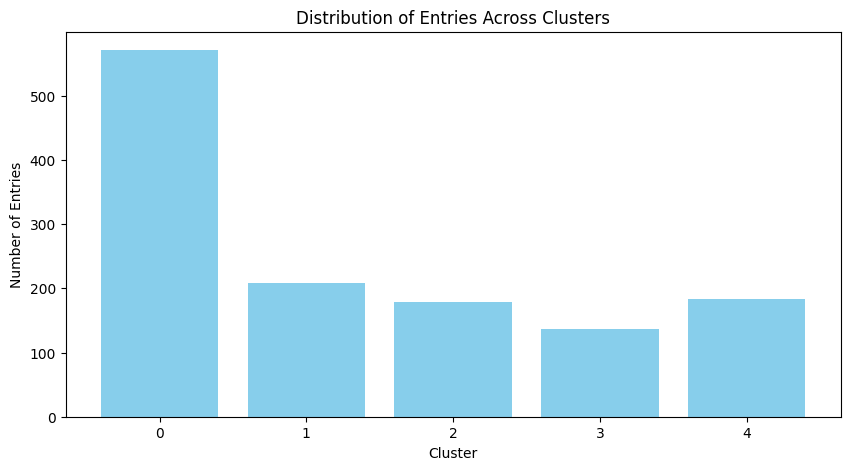

In [54]:
# Plot distributions and clusters
plot_cluster_distributions(labels)

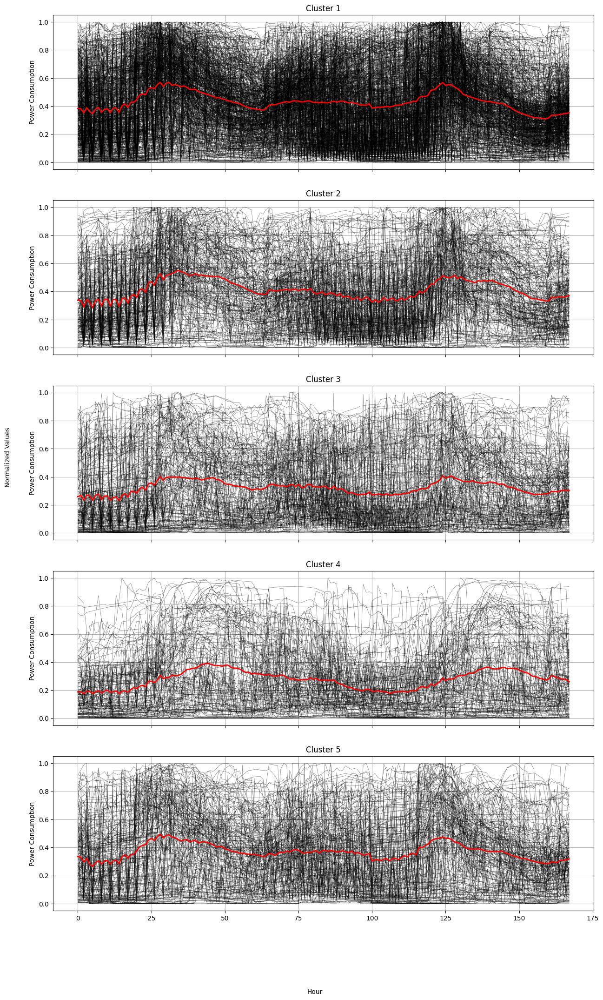

In [55]:
plot_clusters(labels, normalized_data_np, duration='week')

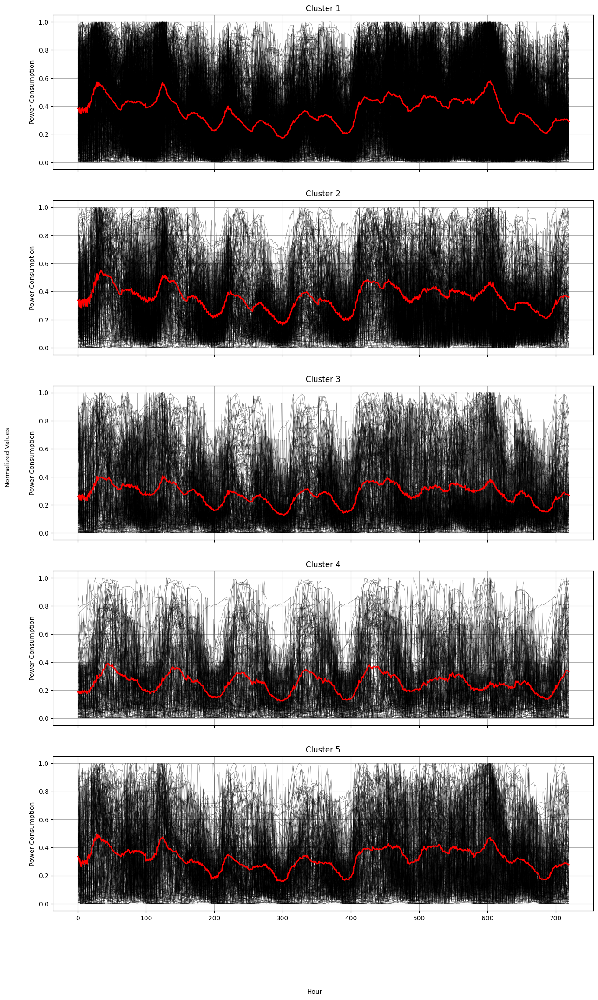

In [56]:
plot_clusters(labels, normalized_data_np, duration='month')

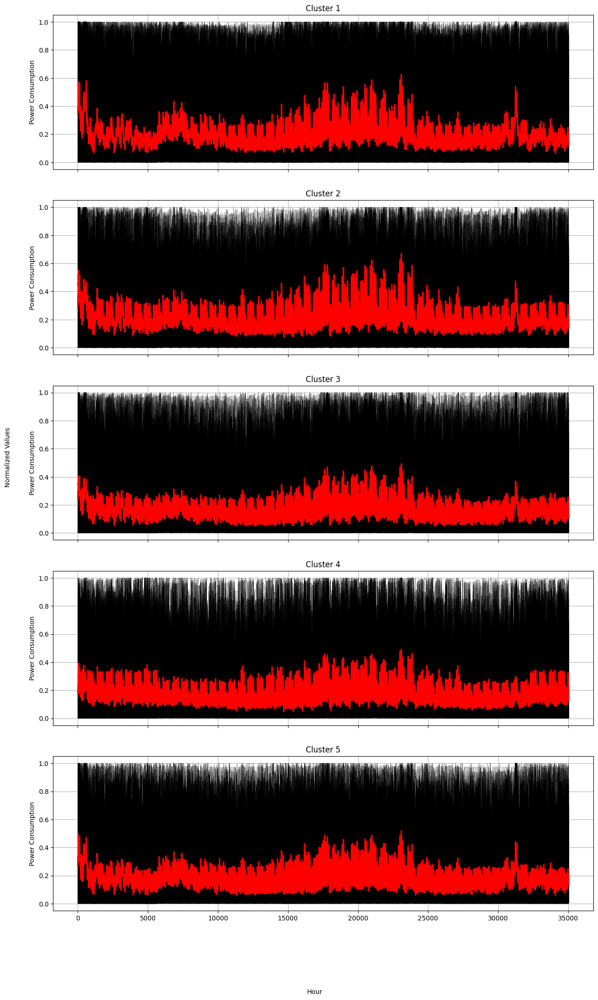

In [57]:
plot_clusters(labels, normalized_data_np)

In [58]:
feature_based_metrics = compute_metrics(normalized_data_np, labels, print_metrics=True)

Silhouette index: -0.021539837534244304
Davies-Bouldin index: 13.228463700535926
Dunn index: 0.04340439992098182
Hartigan index: 64.41942927227635
Calinski-Harabasz index: 4.936398903131154


# 3) Evaluation and Discussion

### 3.1) Explanation of chosen Metrics

Besides the **visual inspection** (above plots) of the formed clusters, five common unsupervised evaluation metrics are used to asses the quality of the clusters.

The five metrics used are the follwing:
  - Silhouette Score
  - Davies-Bouldin Index
  - Dunn Index
  - Hartigan Dip-Test
  - Calinski-Harabasz

### Silhouette Score

The silhouette score is defined by the following equation:

$ \text{Silhouette} = \frac{b - a}{\max(a, b)} \$

where:
- $a$ = average intra-cluster distance,
- $b$ = average shortest distance to another cluster.

Consequently, the silhouette score has a range of $[-1, 1]$, where a score close to $+1$ indicates a
better performance of the clustering algorithm (Yilmaz et al., 2019).

### Davies-Bouldin Index

For a dataset X = {X_1, X_2, X_3, ....} , the Davies-Bouldin Index for k number of clusters can be calculated as

$DB = \frac{1}{k} \Sigma_{i=1}^k max( \frac{\Delta (X_i) + \Delta(X_j)}{\delta(X_i, X_j)}) $

where:
- $\Delta X_k$  is the intracluster distance within the cluster $X_k$        .
- $\delta(X_i, X_j)$  is the intercluster distance between the clusters $X_i\ \text{and} \ X_j$ (GeeksforGeeks, 2023).

The Davies-Bouldin index aims to minimize the ratio of the sum of within-cluster scatter to between-cluster separation. A lower Davies-Bouldin index indicates better clustering performance, as it signifies lower intra-cluster distances (tighter clusters) and higher inter-cluster distances (more distinct clusters) (Davies & Bouldin, 1979).

### Dunn Index

The aim of this Dunn index to identify sets of clusters that are compact, with a small variance between members of the cluster, and well separated, where the means of different clusters are sufficiently far apart, as compared to the within cluster variance.

- Let the size of cluster C be denoted by: $Δ𝐶$
- Let the distance between clusters i and j be denoted by: $𝛿(𝐶𝑖,𝐶𝑗)$

The Dunn index for c number of clusters is defined as :

${\displaystyle DI={\frac {\min \limits _{1\leq i\leq j\leq m}\delta (C_{i},C_{j})}{\max \limits _{1\leq k\leq m}\Delta _{k}}}}$

Higher the Dunn index value, better is the clustering. The number of clusters that maximizes Dunn index is taken as the optimal number of clusters k. It also has some drawbacks. As the number of clusters and dimensionality of the data increase, the computational cost also increases. (Dunn, 1974; Contributors to Wikimedia projects, 2018)


### Hartigan Dip-Test

It calculates the maximum difference between the empirical distribution function and the best-fitting unimodal distribution. In the context of clustering, a lower dip score indicates a more unimodal distribution, suggesting well-defined clusters, whereas a higher dip score indicates a more complex, potentially multimodal distribution, suggesting multiple clusters (Hartigan & Hartigan,  1985).

### Calinski-Harabasz Index

The CH Index is grounded in the principle of maximizing inter-cluster variance while minimizing intra-cluster variance. This balance is crucial for effective clustering:

 - Between-Cluster Variance: This component of the CH Index measures the extent to which clusters are distinct from each other. In an optimal clustering solution, the clusters are well-separated, indicating a high between-cluster variance.

- Within-Cluster Variance: Conversely, this measures how tightly grouped the data points are within each cluster. A lower within-cluster variance signifies that the data points in a cluster are closely related, indicating a more coherent cluster.

The CH Index mathematically formulates this balance as a ratio, comparing the between-cluster variance to the within-cluster variance, normalized by the number of clusters and data points. The result is a score that quantifies the effectiveness of the clustering.

A high CH Index indicates a clustering solution where clusters are both distinct and compact. This score provides a quantifiable way to compare different clustering solutions, guiding the selection of the most appropriate number of clusters (Calinski & Harabasz, 1974; Ribeiro, 2024).

In [59]:
algorithms = ['Autoencoder Manifold', 'Som', 'Daily DTW K-Means', 'Hourly DTW K-Means', 'Feature Based']
metrics = ['Silhouette', 'Davies-Bouldin', 'Dunn', 'Hartigan', 'Calinski-Harabasz']
metric_values = {
    'Autoencoder Manifold': list(autoenc_manifold_metrics),
    'Som': list(som_metrics),
    'Daily DTW K-Means': list(daily_dtw_kmeans_metrics),
    'Hourly DTW K-Means': list(hourly_dtw_kmeans_metrics),
    'Feature Based': list(feature_based_metrics)
}

# Create a DataFrame to store the comparison table
comparison_table = pd.DataFrame(index=metrics, columns=algorithms)

# Determine whether higher or lower values are better for each metric
better_values = {
    'Silhouette': 'higher',
    'Davies-Bouldin': 'lower',
    'Dunn': 'higher',
    'Hartigan': 'lower',
    'Calinski-Harabasz': 'higher'
}

best_matrix = pd.DataFrame(index=metrics, columns=algorithms, dtype=int)

# Selecting the best values and highlighting them for a comparison
for metric in metrics:
    for algorithm in algorithms:
        value = metric_values[algorithm][metrics.index(metric)]
        best_value_func = max if better_values[metric] == 'higher' else min
        is_best = value == best_value_func(metric_values[alg][metrics.index(metric)] for alg in algorithms)
        best_matrix.loc[metric, algorithm] = int(is_best)

def highlight(value):
    return best_matrix.applymap(lambda x: 'font-weight: bold' if x else '')

for metric in metrics:
    for algorithm in algorithms:
        comparison_table.loc[metric, algorithm] = metric_values[algorithm][metrics.index(metric)]

# Apply styling to the comparison_table using the highlight function
styled_comparison_table = comparison_table.style.apply(highlight, axis=None)

pd.options.display.float_format = '{:.2f}'.format

styled_comparison_table

,Autoencoder Manifold,Som,Daily DTW K-Means,Hourly DTW K-Means,Feature Based
Silhouette,0.020301,0.203601,0.095112,0.175348,-0.021540
Davies-Bouldin,3.382911,1.722487,2.233622,2.213591,13.228464
Dunn,0.049663,0.053664,0.053644,0.053080,0.043404
Hartigan,1.644734,1.236704,1.465842,1.316404,64.419429
Calinski-Harabasz,193.344292,343.116394,216.940220,241.567261,4.936399


### 3.2) Final Chosen Approach

The metrics demonstrate that our Self Organizing Maps (Som) approach outperforms all other methods or is evidently close to the best value. Furthermore, the visual evaluation gives us meaningful representative load profiles and clusters. Aggregated load profiles (daily and weekly per season) and an indepth analysation can be found below.

Note: While Self Organizing Maps were the optimal approach, it is possible that Dynamic Time Warping on a lower aggregation level (e.g. per hour) may yield comparable results. We continue to favour the Self-Organising Map (Som) approach due to its efficiency and the advantage of not requiring the user to decide on the number of clusters 'k'.

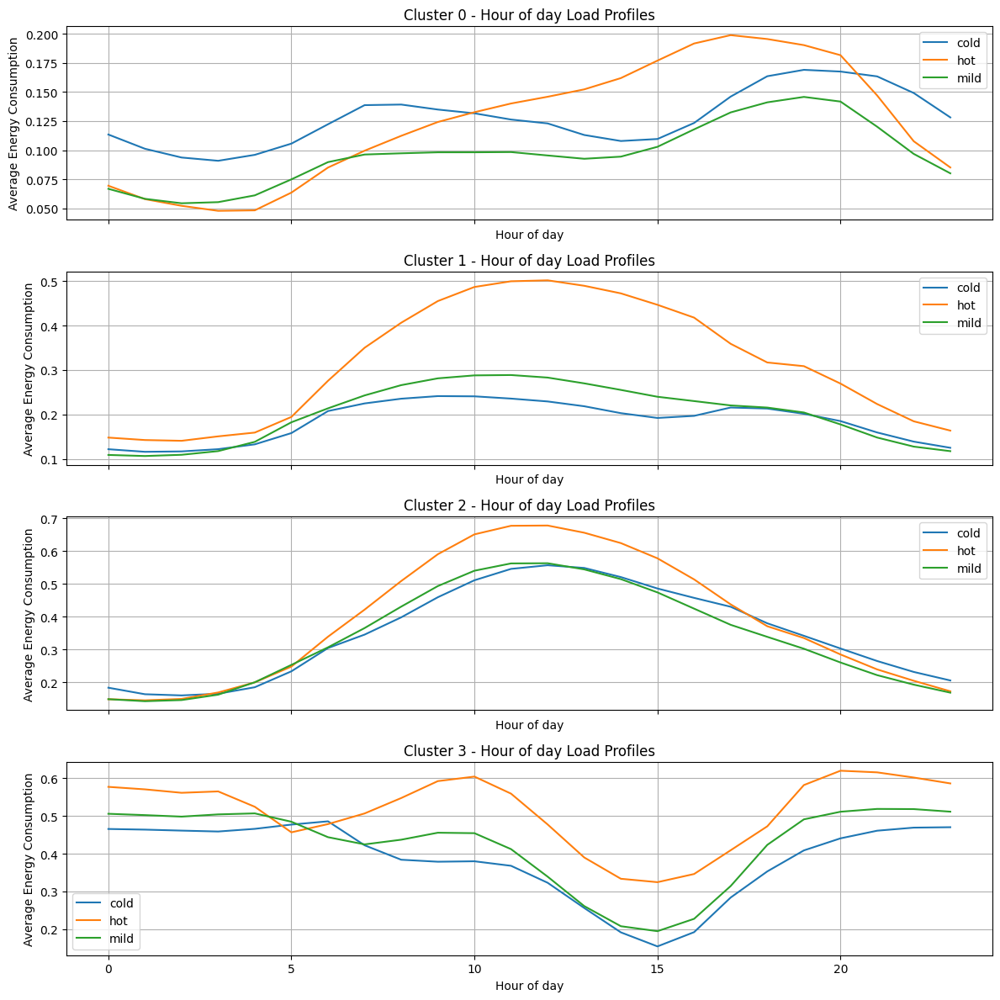

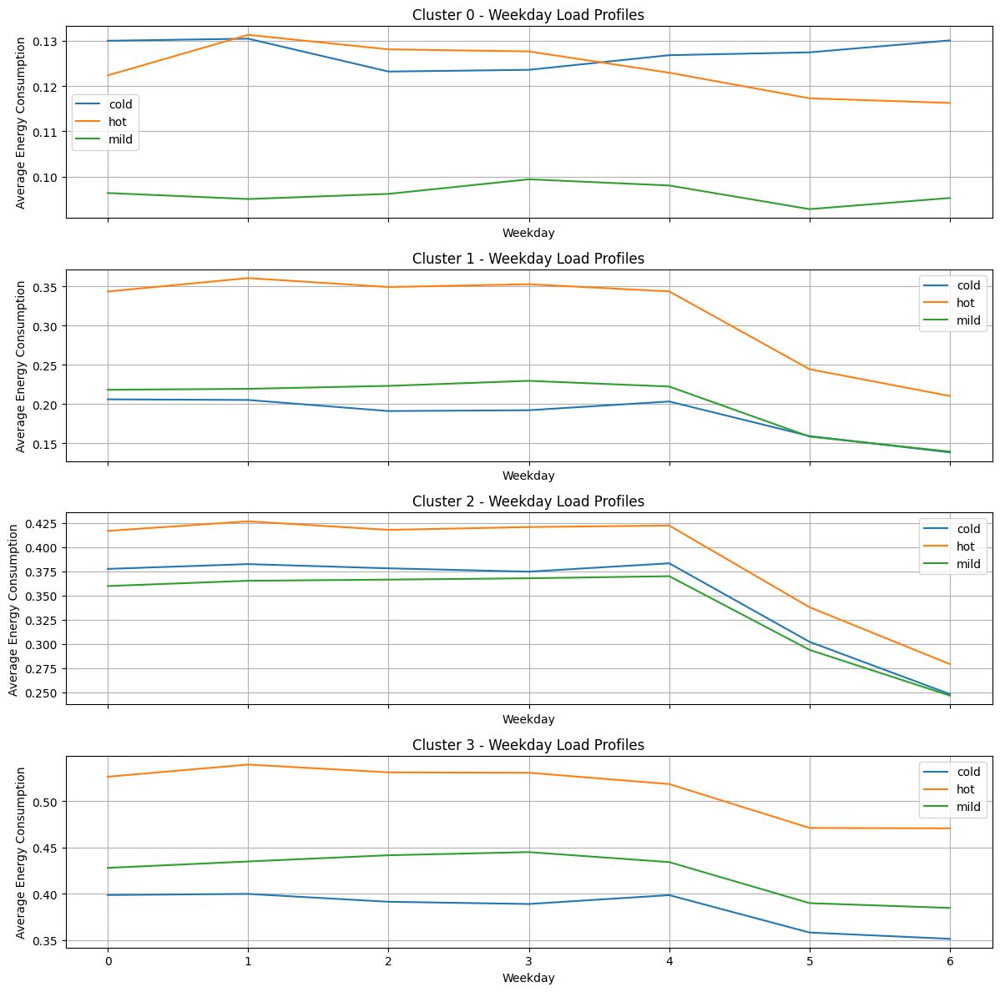

In [60]:
final_labels = methods_labels["som"]

# Map final_labels to buildings
building_ids = normalized_data['building_id'].unique()
building_cluster_map = dict(zip(building_ids, final_labels))

# Add cluster information to the DataFrame
normalized_data['cluster'] = normalized_data['building_id'].map(building_cluster_map)

def plot_load_profiles(normalized_data, SEASONS_MONTHS_DICT, agg_level):
    """
    Plots the load profiles for each cluster based on different aggregation levels.

    Args:
        normalized_data (pd.DataFrame): DataFrame containing the time series data with the following columns:
            - 'building_id': Identifier for each building.
            - 'cluster': Cluster labels assigned to each building.
            - Index: DateTimeIndex representing the time for each data point.
        SEASONS_MONTHS_DICT (dict): Dictionary mapping season names to lists of corresponding month numbers.
        agg_level (str): Aggregation level for plotting the load profiles. 
            Can be one of the following:
            - "Weekday": Aggregate data by weekday.
            - "Hour of day": Aggregate data by hour of the day.

    Returns:
        None: The function displays the plot.
    """
    if agg_level == "Weekday":
        normalized_data['agg_level'] = normalized_data.index.weekday
    elif agg_level == "Hour of day":
        normalized_data['agg_level'] = normalized_data.index.hour

    clusters = normalized_data['cluster'].unique()
    seasons = SEASONS_MONTHS_DICT.keys()
    num_clusters = len(clusters)

    fig, axes = plt.subplots(nrows=num_clusters, ncols=1, figsize=(12, 3 * num_clusters), sharex=True)

    if num_clusters == 1:
        axes = [axes]

    for ax, cluster in zip(axes, clusters):
        for season in seasons:
            season_months = SEASONS_MONTHS_DICT[season]
            season_data = normalized_data[
                (normalized_data['cluster'] == cluster) &
                (normalized_data.index.month.isin(season_months))
            ]

            hourly_avg = season_data.groupby('agg_level')['out.electricity.total.energy_consumption'].mean()

            ax.plot(hourly_avg.index, hourly_avg.values, label=season)

        ax.set_title(f'Cluster {cluster} - {agg_level} Load Profiles')
        ax.set_xlabel(agg_level)
        ax.set_ylabel('Average Energy Consumption')
        ax.legend()
        ax.grid(True)

    plt.tight_layout()
    plt.show()

# Plot the load profiles
plot_load_profiles(normalized_data, SEASONS_MONTHS_DICT, "Hour of day")
plot_load_profiles(normalized_data, SEASONS_MONTHS_DICT, "Weekday")

#### Cluster 0
Cluster 0 displays a relatively consistent load profile with minor peaks and valleys. The average energy consumption shows slight increases during specific hours of the day, and there is evident seasonal variability. In the hourly load profile, energy consumption in hot seasons tends to increase steadily through the day, peaking in the late afternoon and evening. During cold and mild seasons, the consumption patterns are more stable with smaller peaks. On weekdays, the load profile is fairly even, with a small peak in the middle of the week and a drop towards the weekend, especially in hot seasons.

**Interpretation:**
Cluster 0 could represent a mix of residential and small commercial users with relatively stable but slightly varied energy usage patterns throughout the day. These users exhibit more pronounced energy use during hot seasons, likely due to air conditioning.

**Recommendations:**
ToU tariffs for Cluster 0 should focus on reducing late afternoon and evening peaks during hot seasons by encouraging energy usage in the morning or earlier in the day. Higher tariffs during these peak hours can help shift the load to off-peak periods. Additionally, maintaining consistent tariffs during the rest of the year can help in keeping energy consumption stable.

#### Cluster 1:
Cluster 1 exhibits a more stable load profile with fewer peaks, suggesting consistent power usage patterns. The average consumption is relatively steady, with moderate seasonal variability and noticeable peaks in high-usage months. The hourly load profile indicates significant energy use during midday in hot seasons, with more even distribution during cold and mild seasons. Weekday consumption is higher, especially in hot seasons.

**Interpretation:**
Cluster 1 may represent residential buildings. Residential energy consumption tends to be more stable but increases during hot seasons due to air conditioning usage.

**Recommendations:**
ToU tariffs should focus on shifting midday loads to morning or evening periods in hot seasons, while maintaining stability in other seasons. Implementing higher tariffs during peak weekday hours can further incentivize users to adjust their consumption habits, leading to a more balanced load distribution.

#### Cluster 2:
Cluster 2 shows distinct daily cycles with predictable high usage periods, characterized by significant peaks and valleys. The average consumption is consistently high during specific times, with clear seasonal trends showing higher consumption in summer months. The hourly analysis reveals peaks during midday in hot seasons, while cold and mild seasons have peaks in the morning and evening.

**Interpretation:**
Cluster 2 likely represents large commercial or industrial buildings. These buildings have predictable high usage periods due to operational schedules and equipment usage.

**Recommendations:**
ToU tariffs for this cluster should target reducing midday peaks in hot seasons by encouraging load shifting to morning or evening hours. Higher tariffs during peak weekday hours can also promote more efficient energy usage patterns, aligning with demand response objectives.

#### Cluster 3:
Cluster 3 has moderate peaks and valleys with some variability, indicating regular but varied usage patterns. The average consumption remains stable, with seasonal influences causing periodic high usage. The hourly load profile shows less pronounced peaks during hot seasons, with more even distribution across different times of the day. Weekday patterns reveal consistent usage, with slightly higher peaks during hot seasons.

**Interpretation:**
Cluster 3 could represent a mix of residential and small commercial buildings. These buildings exhibit regular usage patterns with some variability due to daily activities.

**Recommendations:**
To optimize this cluster for ToU tariffs, the focus should be on smoothing out moderate peaks by encouraging consistent load distribution throughout the day. Higher tariffs during weekday peaks can incentivize users to shift their consumption to weekends or off-peak hours, contributing to a balanced and stable grid.

#### Overall Recommendations for Time-of-Use (ToU) Tariffs:
1. **Cluster 0:** Implement ToU tariffs to reduce high daytime peaks, particularly encouraging usage in early mornings or late evenings.
2. **Cluster 1:** Similar ToU strategies to Cluster 1, focusing on reducing midday peaks during hot seasons.
3. **Cluster 2:** Introduce ToU tariffs with higher rates during midday peaks in hot seasons to shift loads to morning and evening.
4. **Cluster 3:** Apply ToU tariffs to smooth out the moderate peaks, encouraging consistent load distribution throughout the day.

### 3.3) Exploring model Stability
We test our model stability by retraining the model over several iterations of subsets of the data and computing the rand_index over the assigned clustering.
We achieve a relatively high score and infer that our model is stable. This idea was inspired by Haben et al. (2016).

In [61]:
n_iterations = 50

input_len = normalized_data_np.shape[1]  

mean_rand_index = compute_rand_index_randomly_sampled(normalized_data_np, final_labels, map_size[0], map_size[1], n_iterations=n_iterations)
print(f"Mean Rand Index over {n_iterations} iterations: {mean_rand_index}")

Mean Rand Index over 50 iterations: 0.7540627617473497


# 4) Outlook

In this section, we aim to present an overview of methods and approaches that have not been employed in our work due to time or computational constraints. However, we believe that they remain highly suitable for this task.

One such approach is that proposed by Ruhang (2020), which involves feeding the data into a deep neural network to generate an embedding vector for each load. The embedding vector captures both short-term (daily) and mid-to-long term (monthly) patterns of the load. Clustering is then carried out based on the embeddings of the aggregate loads. Ruhang (2020) claims that his approach is superior to an naive auto-encoding or to approaches where manually calculated and selected features are used to generate representing vectors for clustering.

Furthermore, we would suggest that a Gaussian Mixture Model (GMM) should be employed for clustering purposes, as it offers enhanced feasibility for statistically assessing the robustness of the clusters on a larger scale through bootstrapping, in a manner analogous to the approach employed by Haben et al. (2016).

In light of the growing prevalence of foundational models, particularly LLMs, it is becoming increasingly evident that investing efforts in applying a pretrained foundational time series model to our data may prove beneficial. One potential candidate for this endeavour is the 'Lag-Llama' model proposed by Rasul et al. (2023), which offers a probabilistic interpretation and could therefore facilitate further insights. We hypothesize that the general knowledge across many different time-series datasets could help to identify the important patterns in this challenge. As the 'Lag-Llama' model was trained for forecasting tasks, it may be necessary to make adaptations to ensure its suitability for this purpose.

# 5) References

- Calinski, T. & Harabasz, J. (1974). A dendrite method for cluster analysis. Communications in Statistics. Theory And Methods/Communications in Statistics, Theory And Methods, 3(1), 1–27. https://doi.org/10.1080/03610927408827101

- Cen, S., Yoo, J. H. & Lim, C. G. (2022). Electricity Pattern Analysis by Clustering Domestic Load Profiles Using Discrete Wavelet Transform. Energies, 15(4), 1350. https://doi.org/10.3390/en15041350

- Contributors to Wikimedia projects. (2018, 21. Mai). Dunn index. Simple English Wikipedia, The Free Encyclopedia. https://simple.wikipedia.org/wiki/Dunn_index#:~:text=The%20Dunn%20Index%20(DI)%20is,well%2Dseparated%20from%20other%20clusters.

- Davies, D. L. & Bouldin, D. W. (1979). A cluster separation measure. IEEE Transactions On Pattern Analysis And Machine Intelligence, PAMI-1(2), 224–227. https://doi.org/10.1109/tpami.1979.4766909

- Dunn, J. C. (1974). Well-Separated Clusters and Optimal Fuzzy Partitions. Journal Of Cybernetics, 4(1), 95–104. https://doi.org/10.1080/01969727408546059

- GeeksforGeeks. (2023, 5. November). Davies-Bouldin Index. GeeksforGeeks. https://www.geeksforgeeks.org/davies-bouldin-index/

- Haben, Stephen, Singleton, Colin and Grindrod, Peter (2016)
Analysis and clustering of residential customers energy
behavioral demand using smart meter data. IEEE Transactions
on Smart Grid, 7 (1). pp. 136-144. ISSN 1949-3053 doi:
https://doi.org/10.1109/TSG.2015.240

- Hartigan, J. A., & Hartigan, P. M. (1985). "The Dip Test of Unimodality." The Annals of Statistics, 13(1), 70-84. DOI: 10.1214/aos/1176346577

- Jain, M., AlSkaif, T. & Dev, S. (2021). Validating Clustering Frameworks for Electric Load Demand Profiles. IEEE Transactions On Industrial Informatics, 17(12), 8057–8065. https://doi.org/10.1109/tii.2021.3061470

- McConville, R., Santos-Rodríguez, R., Piechocki, R.J., & Craddock, I. (2020). "N2D: (Not Too) Deep Clustering via Clustering the Local Manifold of an Autoencoded Embedding. "arXiv preprint arXiv:1908.05968.

-  Michalakopoulos, V., Sarmas, E., Papias, I., Skaloumpakas, P., Marinakis, V. & Doukas, H. (2024). A machine learning-based framework for clustering residential electricity load profiles to enhance demand response programs. Applied Energy, 361, 122943. https://doi.org/10.1016/j.apenergy.2024.122943

- Rajabi, A., Eskandari, M., Ghadi, M. J., Li, L., Zhang, J. & Siano, P. (2020). A comparative study of clustering techniques for electrical load pattern segmentation. Renewable & Sustainable Energy Reviews, 120, 109628. https://doi.org/10.1016/j.rser.2019.109628

- Ribeiro, D. (2024, 31. Januar). Optimal clustering - data and beyond - medium. Medium. https://medium.com/data-and-beyond/optimal-clustering-a816e70b0ad3#:~:text=The%20Calinski%2DHarabasz%20Index%2C%20a%20staple%20in%20the%20toolbox%20of,the%20optimal%20number%20of%20clusters.

- Ruhang, X. (2020). Efficient clustering for aggregate loads: An unsupervised pretraining based method. Energy, 210, 118617. https://doi.org/10.1016/j.energy.2020.118617

- Trotta, G. (2020). An empirical analysis of domestic electricity load profiles: Who consumes how much and when? Applied Energy, 275, 115399. https://doi.org/10.1016/j.apenergy.2020.115399


- Yilmaz, S., Chambers, J. & Patel, M. (2019). Comparison of clustering approaches for domestic electricity load profile characterisation - Implications for demand side management. Energy, 180, 665–677. https://doi.org/10.1016/j.energy.2019.05.124


- Rasul, K., Ashok, A., Williams, A. R., Khorasani, A., Adamopoulos, G., Bhagwatkar, R., Biloš, M., Ghonia, H., Hassen, N. V., Schneider, A., Garg, S., Drouin, A., Chapados, N., Nevmyvaka, Y. & Rish, I. (2023). Lag-Llama: Towards Foundation Models for Time Series Forecasting. arXiv (Cornell University). https://doi.org/10.48550/arxiv.2310.08278